**Project42: AI generated Image Detector**



# Data Loader


In [8]:
# mount our Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Data Loader


In [ ]:
cd /content/drive/MyDrive/Project 42

/content/drive/MyDrive/Project 42


In [ ]:
cd RESAE

/content/drive/MyDrive/Project 42/RESAE


In [ ]:
ls

checkpoints_cnnclassifier/  checkpoints_leakydecoder_1e-4/       playing_checkpoints/
checkpoints_l1_leaky/       checkpoints_vanila_decoder_lr_1e-4/


In [9]:
!cp -r "/content/drive/MyDrive/Project 42/processedChameleon/step2" /content/step2


In [10]:
!cp -r "/content/drive/MyDrive/Project 42/new_data_reduced/step2" /content/new_data_step2

In [12]:
import os
import torch
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch.utils.data import DataLoader

# set seed
torch.random.manual_seed(42)


# Define base path to processedChameleon
base_dir = "/content/"
step2_dir = os.path.join(base_dir, "step2")

# Define directories for each split
train_dir = os.path.join(step2_dir, "train")
val_dir   = os.path.join(step2_dir, "val")
test_dir  = os.path.join(step2_dir, "test")

# Define image transforms
train_transform = transforms.Compose([
    transforms.RandomResizedCrop((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406),  # ResNet mean
                         (0.229, 0.224, 0.225)), # ResNet std
])

validation_transform = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406),  # ResNet mean
                         (0.229, 0.224, 0.225)), # ResNet std
])

# Load datasets using ImageFolder
train_dataset = ImageFolder(root=train_dir, transform=train_transform)
val_dataset   = ImageFolder(root=val_dir, transform=validation_transform)
test_dataset  = ImageFolder(root=test_dir, transform=validation_transform)

# Create DataLoaders
batch_size = 64

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
val_loader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

print("Step 2 Train classes:", train_dataset.classes)
print("Step 2 Train samples:", len(train_dataset))
print("Step 2 Validation samples:", len(val_dataset))
print("Step 2 Test samples:", len(test_dataset))


Step 2 Train classes: ['fake', 'real']
Step 2 Train samples: 11148
Step 2 Validation samples: 2972
Step 2 Test samples: 744


In [ ]:
# Create DataLoaders with service worker
batch_size = 64

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, pin_memory=True, persistent_workers=True)
val_loader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True, persistent_workers=True)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True, persistent_workers=True)

In [ ]:
# find number of real and fake images in val_loader
num_real = 0
num_fake = 0
for images, labels in val_loader:
    num_real += (labels == 0).sum().item()
    num_fake += (labels == 1).sum().item()

In [ ]:
print(num_real)
print(num_fake)

1486
1486


In [ ]:
# Define path to step1 real images
step1_base_dir = "/content/drive/MyDrive/Project 42/processedChameleon/step1"

step1_train_dir = os.path.join(step1_base_dir, "train")
step1_val_dir   = os.path.join(step1_base_dir, "val")
step1_test_dir  = os.path.join(step1_base_dir, "test")

# Load datasets — assumes directory structure step1/train/real etc.
step1_train_dataset = ImageFolder(root=step1_train_dir, transform=train_transform)
step1_val_dataset   = ImageFolder(root=step1_val_dir, transform=validation_transform)
step1_test_dataset  = ImageFolder(root=step1_test_dir, transform=validation_transform)

# Create DataLoaders
batch_size = 64
step1_train_loader = DataLoader(step1_train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
step1_val_loader   = DataLoader(step1_val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
step1_test_loader  = DataLoader(step1_test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

print("Step 1 Train classes:", step1_train_dataset.classes)
print("Step 1 Train samples:", len(step1_train_dataset))
print("Step 1 Validation samples:", len(step1_val_dataset))
print("Step 1 Test samples:", len(step1_test_dataset))

Step 1 Train classes: ['real']
Step 1 Train samples: 5573
Step 1 Validation samples: 1486
Step 1 Test samples: 372


## New Data Loader

In [14]:
# Define path to step1 real images
step1_base_dir = "/content/new_data_step2"

step1_train_dir = os.path.join(step1_base_dir, "train")
step1_val_dir   = os.path.join(step1_base_dir, "val")
step1_test_dir  = os.path.join(step1_base_dir, "test")

# Load datasets — assumes directory structure step1/train/real etc.
new_step2_train_dataset = ImageFolder(root=step1_train_dir, transform=train_transform)
new_step2_val_dataset   = ImageFolder(root=step1_val_dir, transform=validation_transform)
new_step2_test_dataset  = ImageFolder(root=step1_test_dir, transform=validation_transform)

# Create DataLoaders
batch_size = 64
new_step2_train_loader = DataLoader(new_step2_train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
new_step2_val_loader   = DataLoader(new_step2_val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
new_step2_test_loader  = DataLoader(new_step2_test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

print("New Step 2 Train classes:", new_step2_train_dataset.classes)
print("New Step 2 Train samples:", len(new_step2_train_dataset))
print("New Step 2 Validation samples:", len(new_step2_val_dataset))
print("New Step 2 Test samples:", len(new_step2_test_dataset))

New Step 2 Train classes: ['fake', 'real']
New Step 2 Train samples: 11877
New Step 2 Validation samples: 3096
New Step 2 Test samples: 811


## A sanity check

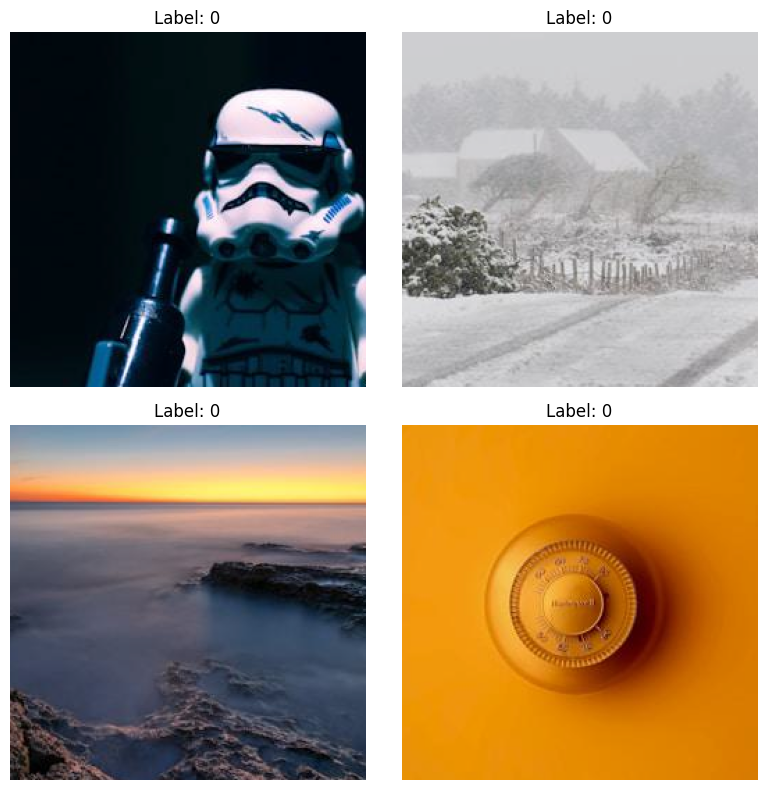

In [ ]:
import matplotlib.pyplot as plt
import numpy as np


# Get a batch of images and labels from the dataloader
images, labels = next(iter(step1_val_loader))

# Display a few images from the batch
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 8))
for i, ax in enumerate(axes.flat):
    # Convert the image from tensor to numpy array
    image = images[i].permute(1, 2, 0).numpy()
    # Denormalize the image (if you applied normalization during preprocessing)
    # Replace mean and std with the values you used for normalization
    mean = [0.485, 0.456, 0.406]
    std = [0.229, 0.224, 0.225]
    image = std * image + mean
    image = np.clip(image, 0, 1) # Clip values to be between 0 and 1
    # Display the image
    ax.imshow(image)
    ax.set_title(f"Label: {labels[i].item()}")
    ax.axis('off')

plt.tight_layout()
plt.show()

# ResNet + Decoder


In [ ]:
import torchvision.models as models
import torch.nn as nn

resnet = models.resnet18(pretrained=True)

for name, layer in resnet.named_children():
    print(f"{name}: {layer}")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 192MB/s]


conv1: Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
bn1: BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
relu: ReLU(inplace=True)
maxpool: MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
layer1: Sequential(
  (0): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (1): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stri

### Resnet Encoder

In [ ]:
encoder = nn.Sequential(*list(resnet.children())[:-2])
for param in encoder.parameters():
    param.requires_grad = False  # 🔒 Freeze all encoder weights

In [ ]:
encoder.eval()  # set to eval mode

# Move to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
resnet_feature_extractor = encoder.to(device)

# Get one batch of images
images, _ = next(iter(step1_train_loader))
images = images.to(device)

# Pass through ResNet feature extractor
with torch.no_grad():
    features = encoder(images)

print("Feature shape:", features.shape)

Feature shape: torch.Size([64, 512, 8, 8])


## Building Decoder

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()

        self.decoder = nn.Sequential(
            # Input: (512, 8, 8) → Output: (256, 16, 16)
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            # (256, 16, 16) → (128, 32, 32)
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            # (128, 32, 32) → (64, 64, 64)
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            # (64, 64, 64) → (32, 128, 128)
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(True),

            # (32, 128, 128) → (3, 256, 256)
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1),
        )

    def forward(self, x):
        return self.decoder(x)


In [ ]:
# ===== Use CUDA if Available =====
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
import torch.optim as optim

def train_decoder(encoder, decoder, train_loader, val_loader,
                  num_epochs=10, lr=1e-4, save_every=5, save_path='./checkpoints'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    encoder = encoder.to(device)
    decoder = decoder.to(device)

    # Freeze encoder
    for param in encoder.parameters():
        param.requires_grad = False
    encoder.eval()

    decoder.train()
    criterion = nn.MSELoss()
    optimizer = optim.Adam(decoder.parameters(), lr=lr)

    os.makedirs(save_path, exist_ok=True)

    train_losses = []
    val_losses = []
    iters = []

    for epoch in range(num_epochs):
        total_train_loss = 0.0
        for imgs, _ in train_loader:
            imgs = imgs.to(device)
            with torch.no_grad():
                features = encoder(imgs)
            outputs = decoder(features)
            loss = criterion(outputs, imgs)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()

        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        # Validation loss
        decoder.eval()
        total_val_loss = 0.0
        with torch.no_grad():
            for imgs, _ in val_loader:
                imgs = imgs.to(device)
                features = encoder(imgs)
                outputs = decoder(features)
                loss = criterion(outputs, imgs)
                total_val_loss += loss.item()
        decoder.train()

        avg_val_loss = total_val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        iters.append(epoch)

        print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

        # Save checkpoints
        if (epoch + 1) % save_every == 0:
            torch.save(decoder.state_dict(), os.path.join(save_path, f'decoder_epoch_{epoch+1}.pth'))

            # Visualize
            imgs = next(iter(val_loader))[0][:4].to(device)
            with torch.no_grad():
                recon = decoder(encoder(imgs)).cpu()
            fig, axes = plt.subplots(2, 4, figsize=(10, 5))
            for i in range(4):
                orig = imgs[i].cpu().permute(1, 2, 0).numpy()
                recon_img = recon[i].permute(1, 2, 0).numpy()
                axes[0, i].imshow(orig.clip(0, 1))
                axes[0, i].set_title("Original")
                axes[0, i].axis('off')
                axes[1, i].imshow(recon_img.clip(0, 1))
                axes[1, i].set_title("Reconstructed")
                axes[1, i].axis('off')
            plt.tight_layout()
            plt.show()

    # Plot loss curve
    plt.figure(figsize=(8, 4))
    plt.plot(iters, train_losses, label='Train Loss')
    plt.plot(iters, val_losses, label='Val Loss')
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.show()

Epoch 1/20 | Train Loss: 1.5224 | Val Loss: 0.9903
Epoch 2/20 | Train Loss: 0.9034 | Val Loss: 0.9139
Epoch 3/20 | Train Loss: 0.8138 | Val Loss: 0.7946
Epoch 4/20 | Train Loss: 0.7904 | Val Loss: 0.7615


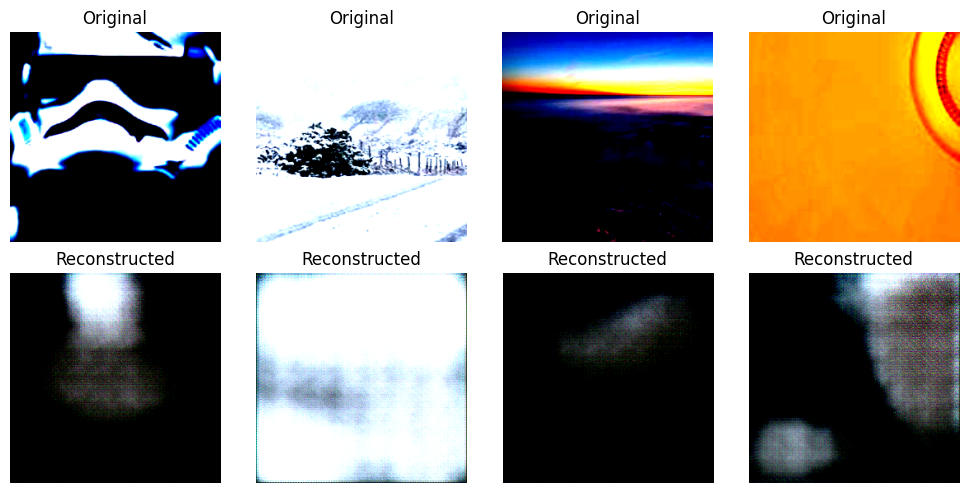

Epoch 5/20 | Train Loss: 0.7624 | Val Loss: 0.7501
Epoch 6/20 | Train Loss: 0.7402 | Val Loss: 0.7363
Epoch 7/20 | Train Loss: 0.7108 | Val Loss: 0.7065
Epoch 8/20 | Train Loss: 0.6929 | Val Loss: 0.6773


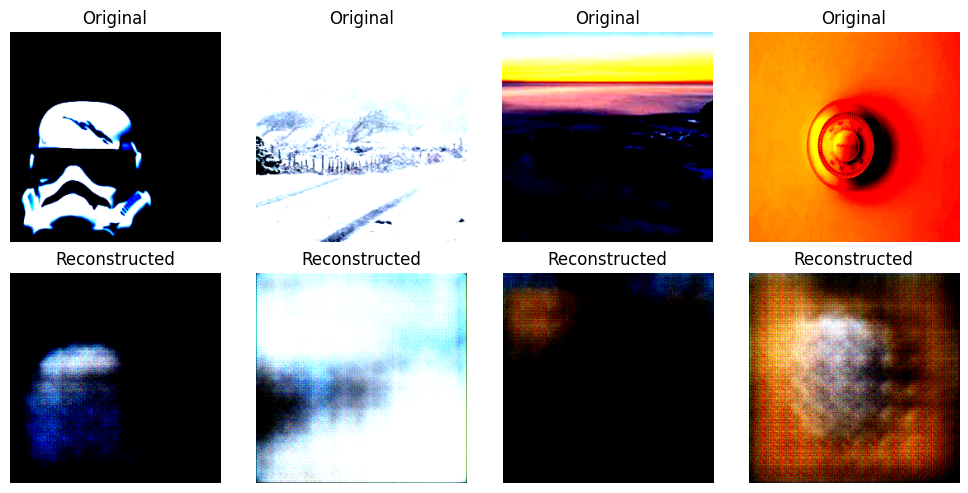

Epoch 9/20 | Train Loss: 0.6829 | Val Loss: 0.7422
Epoch 10/20 | Train Loss: 0.6632 | Val Loss: 0.6521
Epoch 11/20 | Train Loss: 0.6590 | Val Loss: 0.7643
Epoch 12/20 | Train Loss: 0.6459 | Val Loss: 0.6404


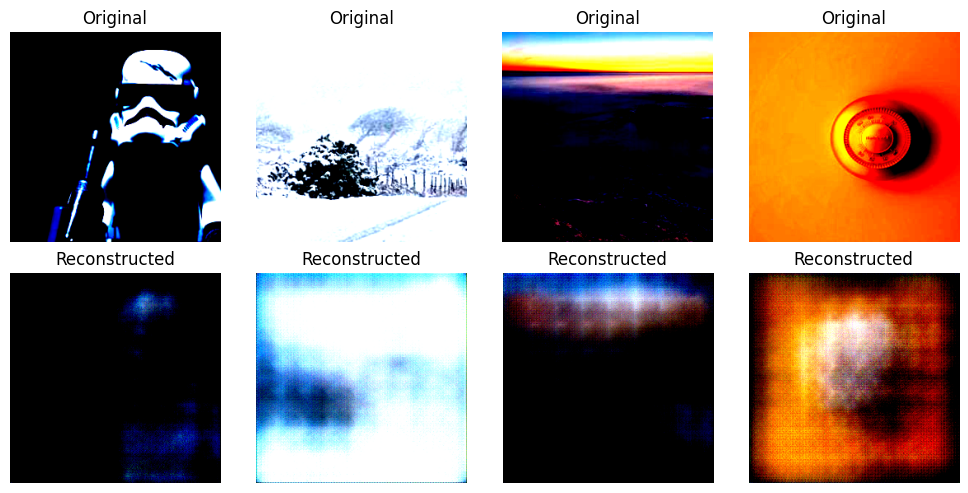

Epoch 13/20 | Train Loss: 0.6313 | Val Loss: 0.7008
Epoch 14/20 | Train Loss: 0.6144 | Val Loss: 0.6213
Epoch 15/20 | Train Loss: 0.6073 | Val Loss: 0.6696
Epoch 16/20 | Train Loss: 0.6077 | Val Loss: 0.6463


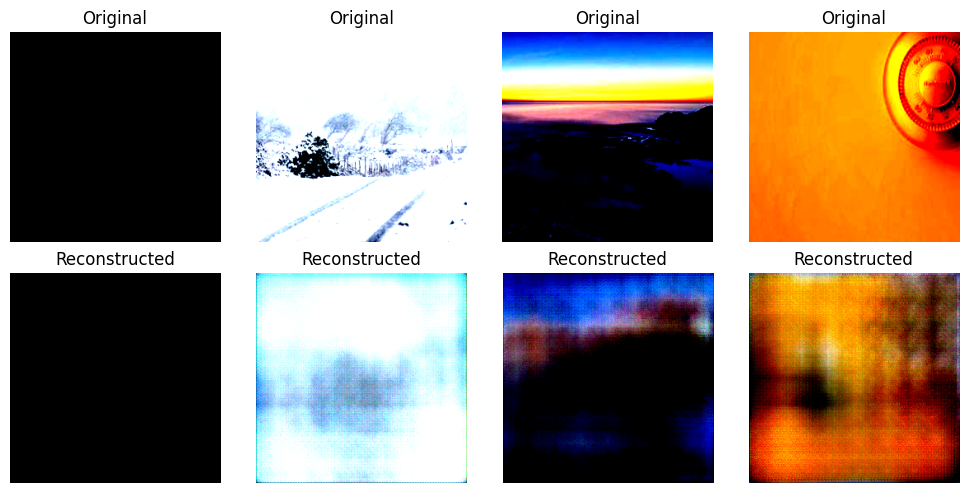

Epoch 17/20 | Train Loss: 0.5969 | Val Loss: 0.6283
Epoch 18/20 | Train Loss: 0.5924 | Val Loss: 0.5965
Epoch 19/20 | Train Loss: 0.5940 | Val Loss: 0.6180
Epoch 20/20 | Train Loss: 0.5796 | Val Loss: 0.6214


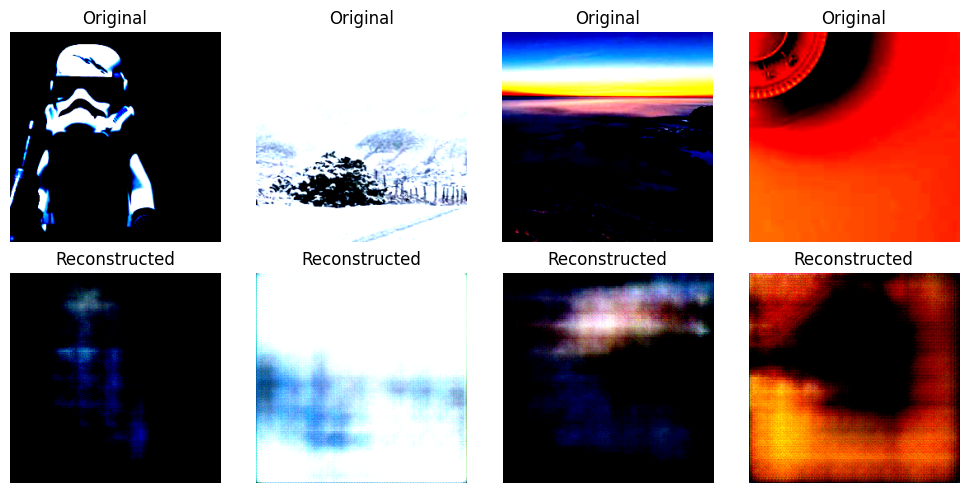

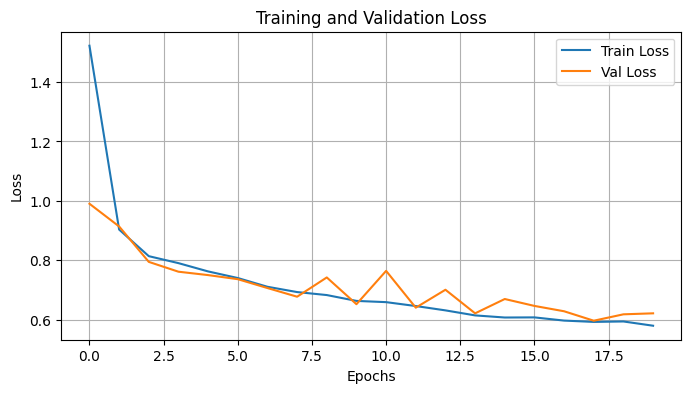

In [ ]:
decoder = Decoder()
train_decoder(resnet_feature_extractor, decoder, step1_train_loader, step1_val_loader,
              num_epochs=20, lr= 1e-4, save_every=4)

In [ ]:
def train_decoder(encoder, decoder, train_loader, val_loader,
                 num_epochs=10, lr=1e-4, save_every=5, save_path='./checkpoints'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    encoder = encoder.to(device)
    decoder = decoder.to(device)

    # Define denormalization function
    def denormalize(tensor):
      """Denormalizes an image tensor.
      Input: (B, C, H, W) or (C, H, W)
      Output: Denormalized image tensor, same shape as input.
      """
      mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).cpu()
      std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).cpu()
      return tensor * std + mean

    # Store fixed batch for visualization
    fixed_batch, _ = next(iter(val_loader))
    fixed_batch = fixed_batch[:4].to(device)

    # Freeze encoder
    for param in encoder.parameters():
        param.requires_grad = False
    encoder.eval()

    decoder.train()
    criterion = nn.MSELoss()
    optimizer = optim.Adam(decoder.parameters(), lr=lr)

    os.makedirs(save_path, exist_ok=True)

    train_losses = []
    val_losses = []
    iters = []

    for epoch in range(num_epochs):
        total_train_loss = 0.0
        for imgs, _ in train_loader:
            imgs = imgs.to(device)
            with torch.no_grad():
                features = encoder(imgs)
            outputs = decoder(features)
            loss = criterion(outputs, imgs)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()

        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        # Validation loss
        decoder.eval()
        total_val_loss = 0.0
        with torch.no_grad():
            for imgs, _ in val_loader:
                imgs = imgs.to(device)
                features = encoder(imgs)
                outputs = decoder(features)
                loss = criterion(outputs, imgs)
                total_val_loss += loss.item()
        decoder.train()

        avg_val_loss = total_val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        iters.append(epoch)

        print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

        # Save checkpoints and visualize
        if (epoch + 1) % save_every == 0:
            torch.save(decoder.state_dict(), os.path.join(save_path, f'decoder_epoch_{epoch+1}.pth'))

            # Visualize fixed batch
            with torch.no_grad():
                recon = decoder(encoder(fixed_batch))

            fig, axes = plt.subplots(2, 4, figsize=(10, 5))
            for i in range(4):
                # Original (denormalized)
                orig = denormalize(fixed_batch[i].cpu()).squeeze(0).permute(1, 2, 0).numpy()
                axes[0, i].imshow(orig.clip(0, 1))
                axes[0, i].set_title("Original")
                axes[0, i].axis('off')

                # Reconstruction (denormalized)
                recon_img = denormalize(recon[i].cpu()).squeeze(0),permute(1, 2, 0).numpy()
                axes[1, i].imshow(recon_img.clip(0, 1))
                axes[1, i].set_title("Reconstructed")
                axes[1, i].axis('off')

            plt.tight_layout()
            plt.show()

    # Plot loss curve
    plt.figure(figsize=(8, 4))
    plt.plot(iters, train_losses, label='Train Loss')
    plt.plot(iters, val_losses, label='Val Loss')
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.show()

Using device: cuda
Epoch 1/2 | Train Loss: 1.4162 | Val Loss: 0.9342


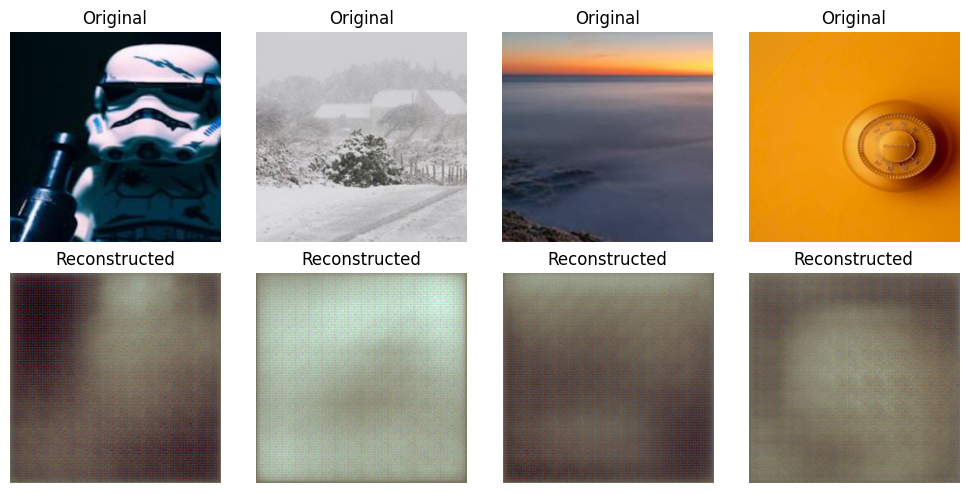

Epoch 2/2 | Train Loss: 0.8583 | Val Loss: 0.8303


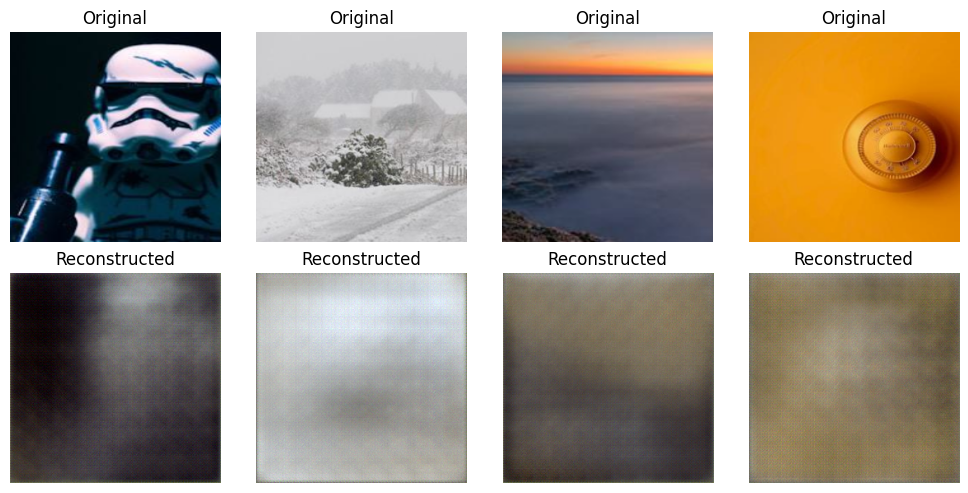

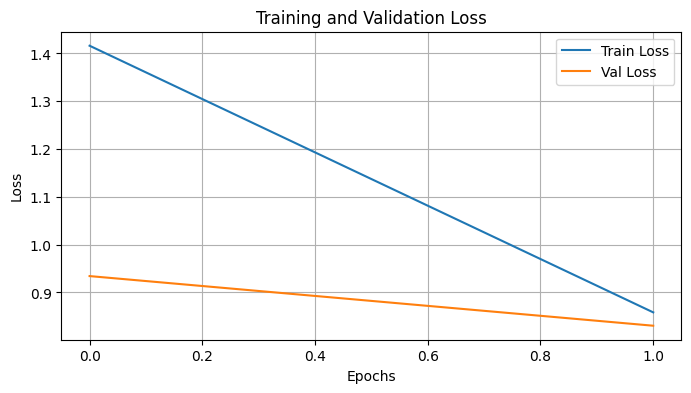

In [ ]:
decoder = Decoder()
train_decoder(resnet_feature_extractor, decoder, step1_train_loader, step1_val_loader,
              num_epochs=2, lr= 1e-4, save_every=1)

Using device: cuda
Epoch 1/100 | Train Loss: 1.3361 | Val Loss: 0.9075
Epoch 2/100 | Train Loss: 0.8657 | Val Loss: 0.8434
Epoch 3/100 | Train Loss: 0.7980 | Val Loss: 0.7635
Epoch 4/100 | Train Loss: 0.7458 | Val Loss: 0.7136
Epoch 5/100 | Train Loss: 0.7093 | Val Loss: 0.6936
Epoch 6/100 | Train Loss: 0.6904 | Val Loss: 0.6774
Epoch 7/100 | Train Loss: 0.6743 | Val Loss: 0.6739
Epoch 8/100 | Train Loss: 0.6697 | Val Loss: 0.7597
Epoch 9/100 | Train Loss: 0.6640 | Val Loss: 0.6718
Epoch 10/100 | Train Loss: 0.6493 | Val Loss: 0.6693


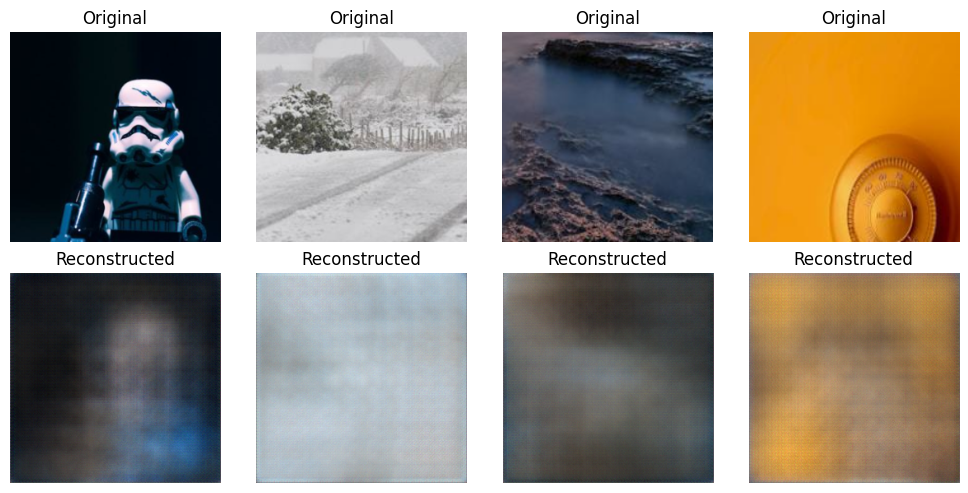

Epoch 11/100 | Train Loss: 0.6379 | Val Loss: 0.6368
Epoch 12/100 | Train Loss: 0.6279 | Val Loss: 0.6331
Epoch 13/100 | Train Loss: 0.6183 | Val Loss: 0.6355
Epoch 14/100 | Train Loss: 0.6148 | Val Loss: 0.6278
Epoch 15/100 | Train Loss: 0.6142 | Val Loss: 0.7963
Epoch 16/100 | Train Loss: 0.6193 | Val Loss: 0.6206
Epoch 17/100 | Train Loss: 0.5969 | Val Loss: 0.6579
Epoch 18/100 | Train Loss: 0.5918 | Val Loss: 0.6108
Epoch 19/100 | Train Loss: 0.5838 | Val Loss: 0.6200
Epoch 20/100 | Train Loss: 0.5867 | Val Loss: 0.6038


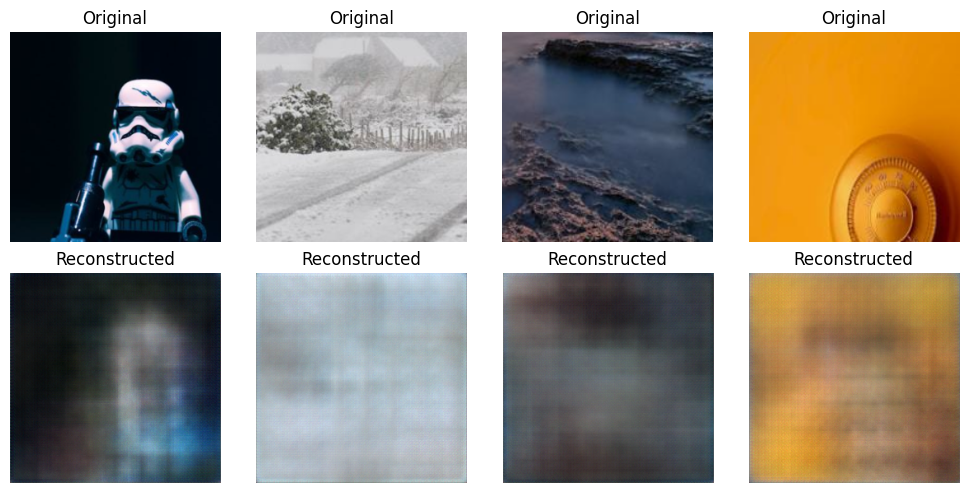

Epoch 21/100 | Train Loss: 0.5795 | Val Loss: 0.6037
Epoch 22/100 | Train Loss: 0.5740 | Val Loss: 0.6265
Epoch 23/100 | Train Loss: 0.5720 | Val Loss: 0.6067
Epoch 24/100 | Train Loss: 0.5775 | Val Loss: 0.5934
Epoch 25/100 | Train Loss: 0.5652 | Val Loss: 0.5780
Epoch 26/100 | Train Loss: 0.5616 | Val Loss: 0.5953
Epoch 27/100 | Train Loss: 0.5707 | Val Loss: 0.5942
Epoch 28/100 | Train Loss: 0.5574 | Val Loss: 0.5919
Epoch 29/100 | Train Loss: 0.5487 | Val Loss: 0.6181
Epoch 30/100 | Train Loss: 0.5507 | Val Loss: 0.6341


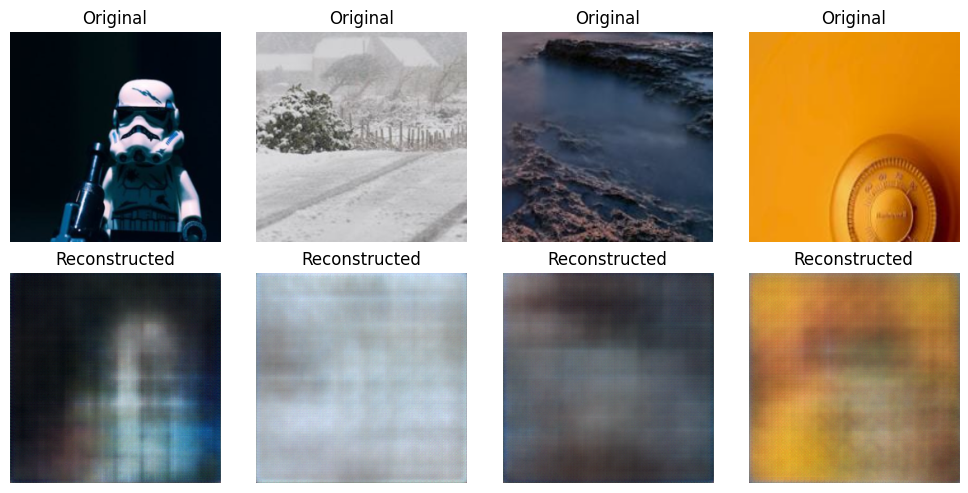

Epoch 31/100 | Train Loss: 0.5510 | Val Loss: 0.6272
Epoch 32/100 | Train Loss: 0.5431 | Val Loss: 0.5892
Epoch 33/100 | Train Loss: 0.5541 | Val Loss: 0.7289
Epoch 34/100 | Train Loss: 0.5502 | Val Loss: 0.5742
Epoch 35/100 | Train Loss: 0.5401 | Val Loss: 0.5869
Epoch 36/100 | Train Loss: 0.5399 | Val Loss: 0.6123
Epoch 37/100 | Train Loss: 0.5416 | Val Loss: 0.6211
Epoch 38/100 | Train Loss: 0.5338 | Val Loss: 0.5827
Epoch 39/100 | Train Loss: 0.5348 | Val Loss: 0.7379
Epoch 40/100 | Train Loss: 0.5315 | Val Loss: 0.6971


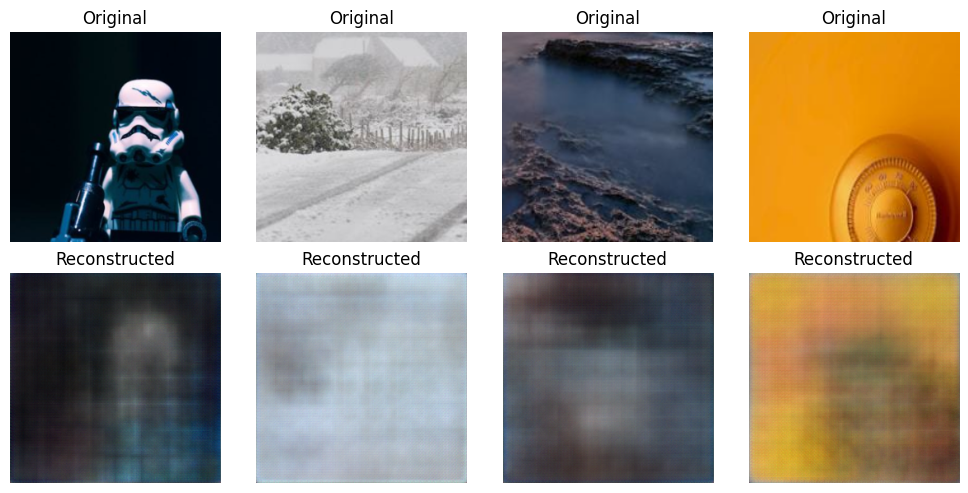

Epoch 41/100 | Train Loss: 0.5294 | Val Loss: 0.5619
Epoch 42/100 | Train Loss: 0.5283 | Val Loss: 0.5908
Epoch 43/100 | Train Loss: 0.5324 | Val Loss: 0.5698
Epoch 44/100 | Train Loss: 0.5165 | Val Loss: 0.5574
Epoch 45/100 | Train Loss: 0.5226 | Val Loss: 0.5719
Epoch 46/100 | Train Loss: 0.5272 | Val Loss: 0.7450
Epoch 47/100 | Train Loss: 0.5225 | Val Loss: 0.5669
Epoch 48/100 | Train Loss: 0.5174 | Val Loss: 0.5821
Epoch 49/100 | Train Loss: 0.5199 | Val Loss: 0.5724
Epoch 50/100 | Train Loss: 0.5183 | Val Loss: 0.5610


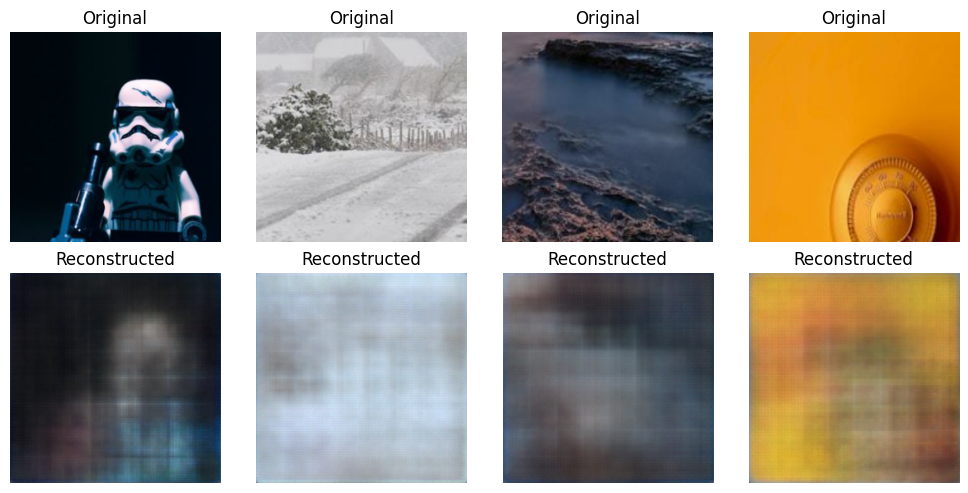

Epoch 51/100 | Train Loss: 0.5130 | Val Loss: 0.6032
Epoch 52/100 | Train Loss: 0.5210 | Val Loss: 0.5825
Epoch 53/100 | Train Loss: 0.5091 | Val Loss: 0.5765
Epoch 54/100 | Train Loss: 0.5058 | Val Loss: 0.5667
Epoch 55/100 | Train Loss: 0.5073 | Val Loss: 0.5674
Epoch 56/100 | Train Loss: 0.5070 | Val Loss: 0.5853
Epoch 57/100 | Train Loss: 0.5070 | Val Loss: 0.5562
Epoch 58/100 | Train Loss: 0.5055 | Val Loss: 0.5658
Epoch 59/100 | Train Loss: 0.5072 | Val Loss: 0.5585
Epoch 60/100 | Train Loss: 0.4953 | Val Loss: 0.5678


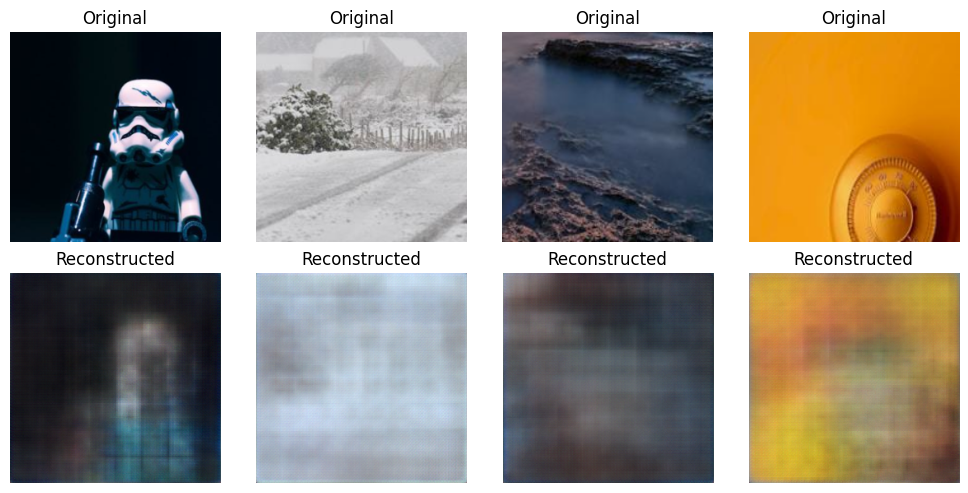

Epoch 61/100 | Train Loss: 0.5000 | Val Loss: 0.5969
Epoch 62/100 | Train Loss: 0.4988 | Val Loss: 0.5571
Epoch 63/100 | Train Loss: 0.5079 | Val Loss: 0.6304
Epoch 64/100 | Train Loss: 0.5064 | Val Loss: 0.5537
Epoch 65/100 | Train Loss: 0.4927 | Val Loss: 0.5531
Epoch 66/100 | Train Loss: 0.4925 | Val Loss: 0.5925
Epoch 67/100 | Train Loss: 0.5003 | Val Loss: 0.5510
Epoch 68/100 | Train Loss: 0.4946 | Val Loss: 0.5538
Epoch 69/100 | Train Loss: 0.4915 | Val Loss: 0.5507
Epoch 70/100 | Train Loss: 0.4908 | Val Loss: 0.5506


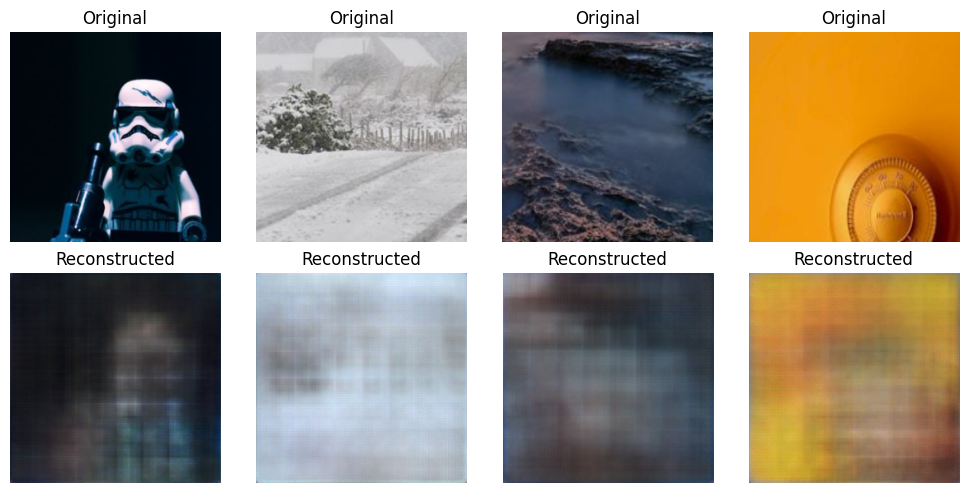

Epoch 71/100 | Train Loss: 0.4962 | Val Loss: 0.5835
Epoch 72/100 | Train Loss: 0.5004 | Val Loss: 0.6541
Epoch 73/100 | Train Loss: 0.4969 | Val Loss: 0.5991
Epoch 74/100 | Train Loss: 0.5003 | Val Loss: 0.5486
Epoch 75/100 | Train Loss: 0.4908 | Val Loss: 0.5533
Epoch 76/100 | Train Loss: 0.4889 | Val Loss: 0.5459
Epoch 77/100 | Train Loss: 0.4913 | Val Loss: 0.6451
Epoch 78/100 | Train Loss: 0.4896 | Val Loss: 0.5978
Epoch 79/100 | Train Loss: 0.4847 | Val Loss: 0.5505
Epoch 80/100 | Train Loss: 0.4831 | Val Loss: 0.5544


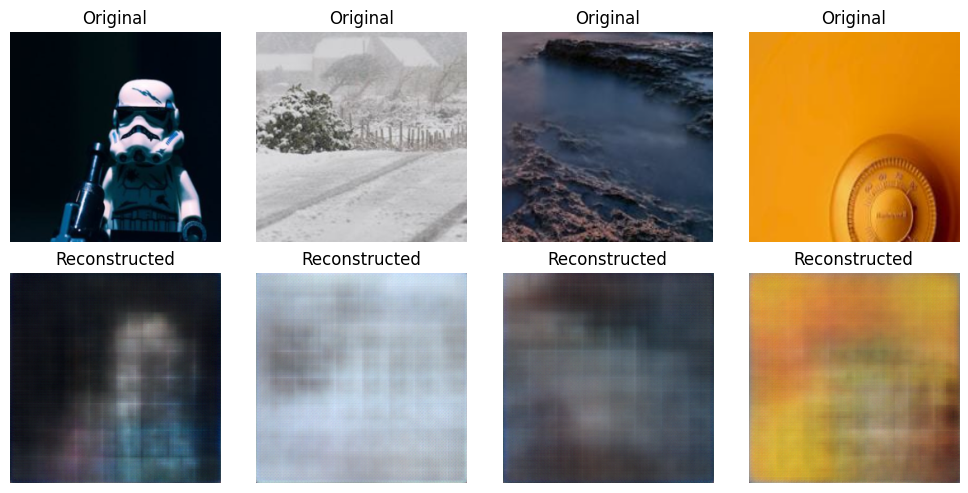

Epoch 81/100 | Train Loss: 0.4855 | Val Loss: 0.5785
Epoch 82/100 | Train Loss: 0.4808 | Val Loss: 0.5623
Epoch 83/100 | Train Loss: 0.4817 | Val Loss: 0.5704
Epoch 84/100 | Train Loss: 0.4783 | Val Loss: 0.5665
Epoch 85/100 | Train Loss: 0.4803 | Val Loss: 0.5604
Epoch 86/100 | Train Loss: 0.4792 | Val Loss: 0.5768
Epoch 87/100 | Train Loss: 0.4781 | Val Loss: 0.5553
Epoch 88/100 | Train Loss: 0.4781 | Val Loss: 0.5472
Epoch 89/100 | Train Loss: 0.4742 | Val Loss: 0.5506
Epoch 90/100 | Train Loss: 0.4759 | Val Loss: 0.5617


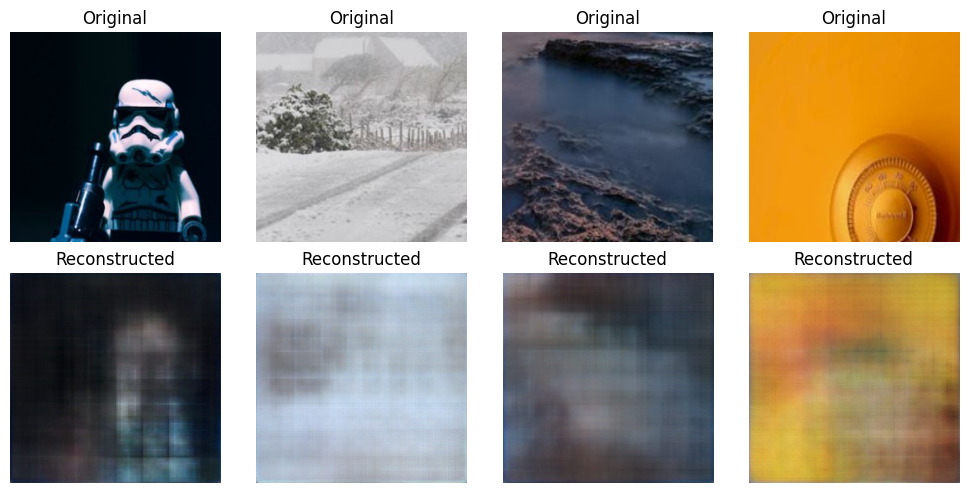

Epoch 91/100 | Train Loss: 0.4748 | Val Loss: 0.5474
Epoch 92/100 | Train Loss: 0.4772 | Val Loss: 0.5674
Epoch 93/100 | Train Loss: 0.4729 | Val Loss: 0.5459
Epoch 94/100 | Train Loss: 0.4718 | Val Loss: 0.5468
Epoch 95/100 | Train Loss: 0.4797 | Val Loss: 0.6773
Epoch 96/100 | Train Loss: 0.4874 | Val Loss: 0.5561
Epoch 97/100 | Train Loss: 0.4712 | Val Loss: 0.5838
Epoch 98/100 | Train Loss: 0.4709 | Val Loss: 0.5435
Epoch 99/100 | Train Loss: 0.4679 | Val Loss: 0.5686
Epoch 100/100 | Train Loss: 0.4719 | Val Loss: 0.5509


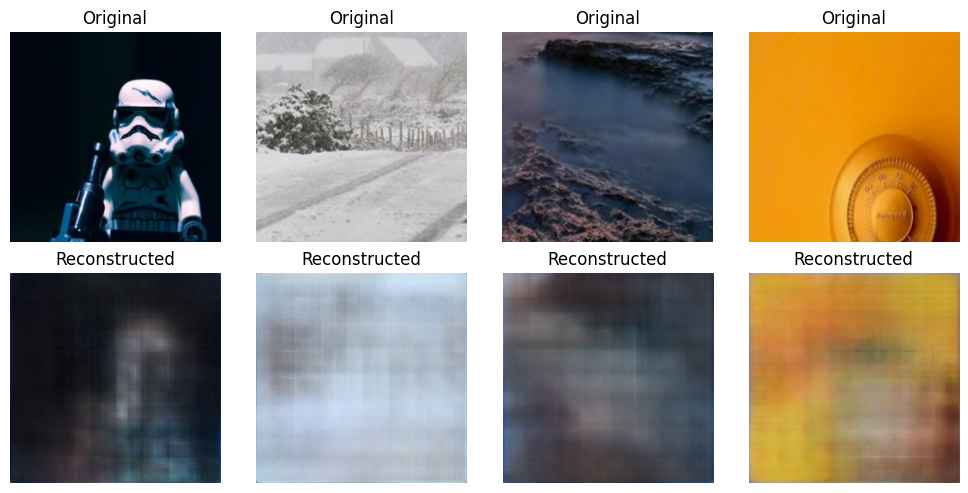

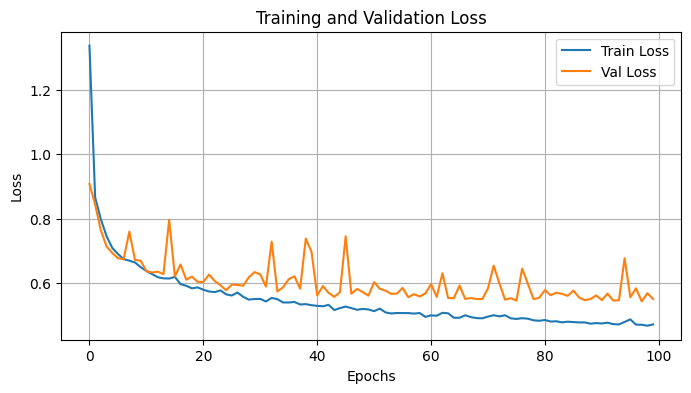

In [ ]:
decoder = Decoder()
train_decoder(resnet_feature_extractor, decoder, step1_train_loader, step1_val_loader,
              num_epochs=100, lr= 1e-4, save_every=10)

Using device: cuda
Epoch 1/50 | Train Loss: 1.5730 | Val Loss: 1.1488
Epoch 2/50 | Train Loss: 0.9184 | Val Loss: 0.8775
Epoch 3/50 | Train Loss: 0.7733 | Val Loss: 0.8139
Epoch 4/50 | Train Loss: 0.7423 | Val Loss: 0.8313
Epoch 5/50 | Train Loss: 0.7099 | Val Loss: 0.7884
Epoch 6/50 | Train Loss: 0.6920 | Val Loss: 0.7788
Epoch 7/50 | Train Loss: 0.6693 | Val Loss: 0.7595
Epoch 8/50 | Train Loss: 0.6665 | Val Loss: 0.7813
Epoch 9/50 | Train Loss: 0.6546 | Val Loss: 0.7650
Epoch 10/50 | Train Loss: 0.6403 | Val Loss: 0.7197


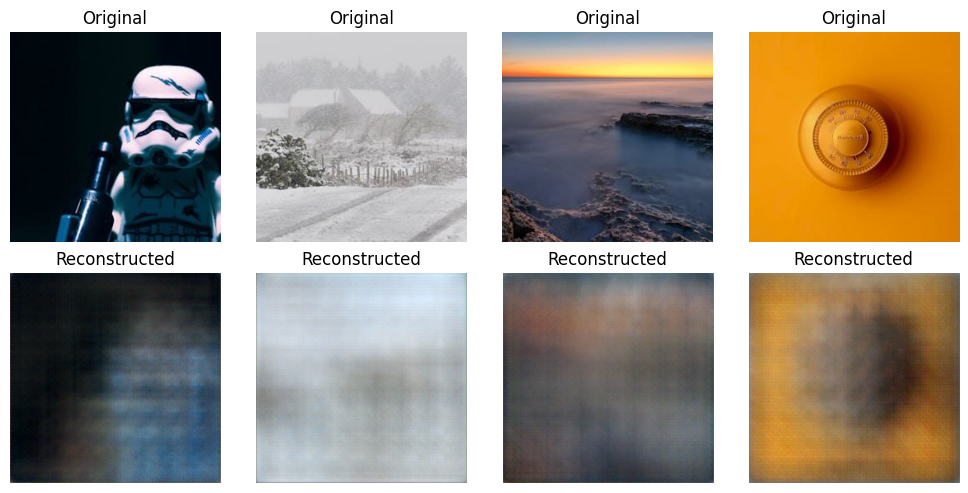

Epoch 11/50 | Train Loss: 0.6431 | Val Loss: 0.8362
Epoch 12/50 | Train Loss: 0.6327 | Val Loss: 0.7150
Epoch 13/50 | Train Loss: 0.6145 | Val Loss: 0.7294
Epoch 14/50 | Train Loss: 0.6084 | Val Loss: 0.7291
Epoch 15/50 | Train Loss: 0.6091 | Val Loss: 0.7021
Epoch 16/50 | Train Loss: 0.6144 | Val Loss: 0.8710
Epoch 17/50 | Train Loss: 0.6104 | Val Loss: 0.7718
Epoch 18/50 | Train Loss: 0.6004 | Val Loss: 0.7031
Epoch 19/50 | Train Loss: 0.5892 | Val Loss: 0.7163
Epoch 20/50 | Train Loss: 0.5784 | Val Loss: 0.6823


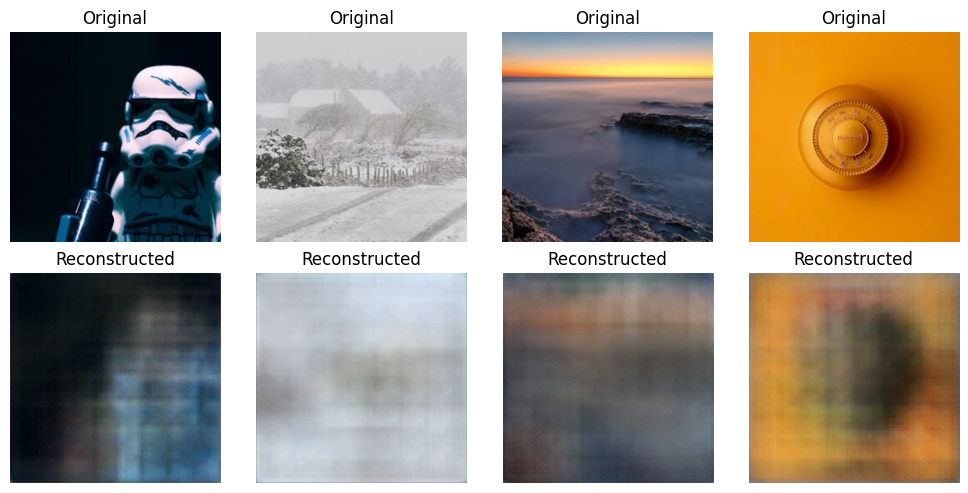

Epoch 21/50 | Train Loss: 0.5822 | Val Loss: 0.7014
Epoch 22/50 | Train Loss: 0.5721 | Val Loss: 0.6789
Epoch 23/50 | Train Loss: 0.5727 | Val Loss: 0.6828
Epoch 24/50 | Train Loss: 0.5702 | Val Loss: 0.6753
Epoch 25/50 | Train Loss: 0.5673 | Val Loss: 0.6734
Epoch 26/50 | Train Loss: 0.5595 | Val Loss: 0.6800
Epoch 27/50 | Train Loss: 0.5576 | Val Loss: 0.6813
Epoch 28/50 | Train Loss: 0.5509 | Val Loss: 0.6611
Epoch 29/50 | Train Loss: 0.5512 | Val Loss: 0.6649
Epoch 30/50 | Train Loss: 0.5410 | Val Loss: 0.6713


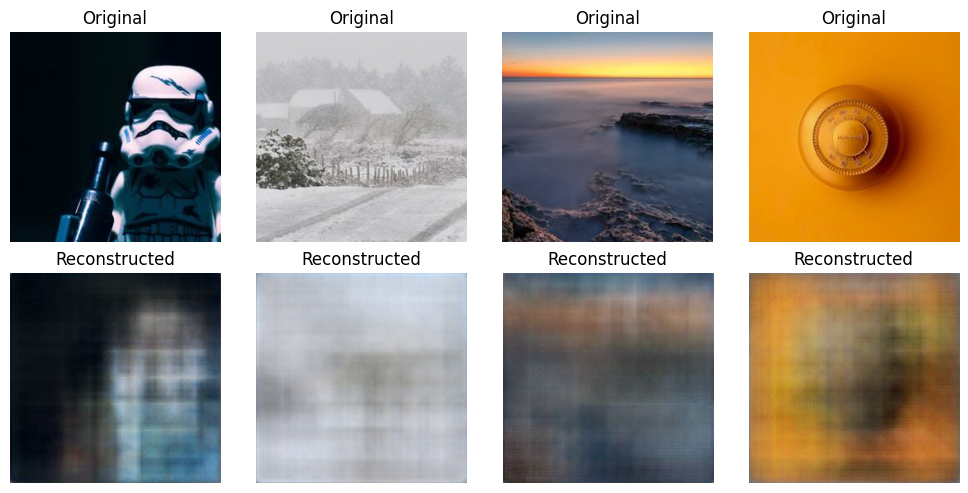

Epoch 31/50 | Train Loss: 0.5443 | Val Loss: 0.6888
Epoch 32/50 | Train Loss: 0.5446 | Val Loss: 0.6699
Epoch 33/50 | Train Loss: 0.5393 | Val Loss: 0.6596
Epoch 34/50 | Train Loss: 0.5394 | Val Loss: 0.6535
Epoch 35/50 | Train Loss: 0.5388 | Val Loss: 0.6681
Epoch 36/50 | Train Loss: 0.5402 | Val Loss: 0.6680
Epoch 37/50 | Train Loss: 0.5342 | Val Loss: 0.6512
Epoch 38/50 | Train Loss: 0.5299 | Val Loss: 0.6807
Epoch 39/50 | Train Loss: 0.5349 | Val Loss: 0.6697
Epoch 40/50 | Train Loss: 0.5299 | Val Loss: 0.6560


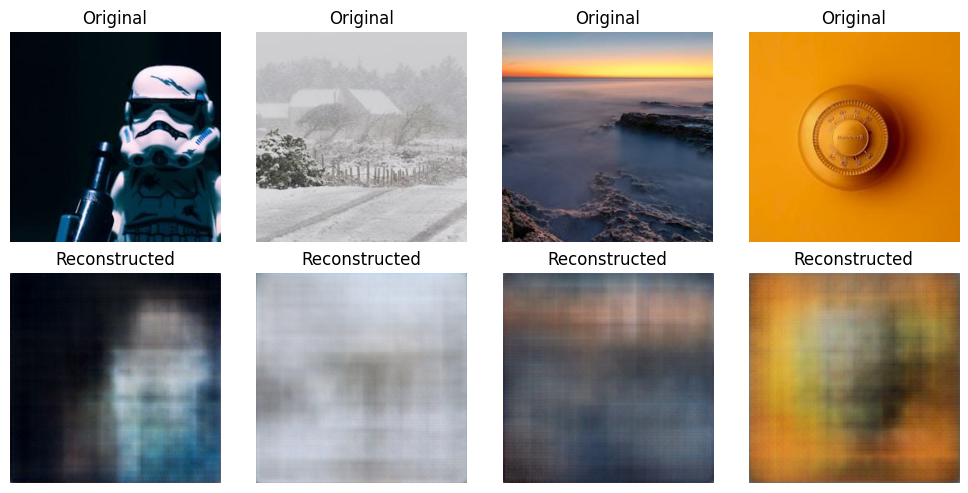

Epoch 41/50 | Train Loss: 0.5255 | Val Loss: 0.6534
Epoch 42/50 | Train Loss: 0.5235 | Val Loss: 0.6556
Epoch 43/50 | Train Loss: 0.5192 | Val Loss: 0.7145
Epoch 44/50 | Train Loss: 0.5107 | Val Loss: 0.6629
Epoch 45/50 | Train Loss: 0.5277 | Val Loss: 0.7087
Epoch 46/50 | Train Loss: 0.5170 | Val Loss: 0.6573
Epoch 47/50 | Train Loss: 0.5180 | Val Loss: 0.6768
Epoch 48/50 | Train Loss: 0.5090 | Val Loss: 0.6483
Epoch 49/50 | Train Loss: 0.5166 | Val Loss: 0.6661
Epoch 50/50 | Train Loss: 0.5195 | Val Loss: 0.6875


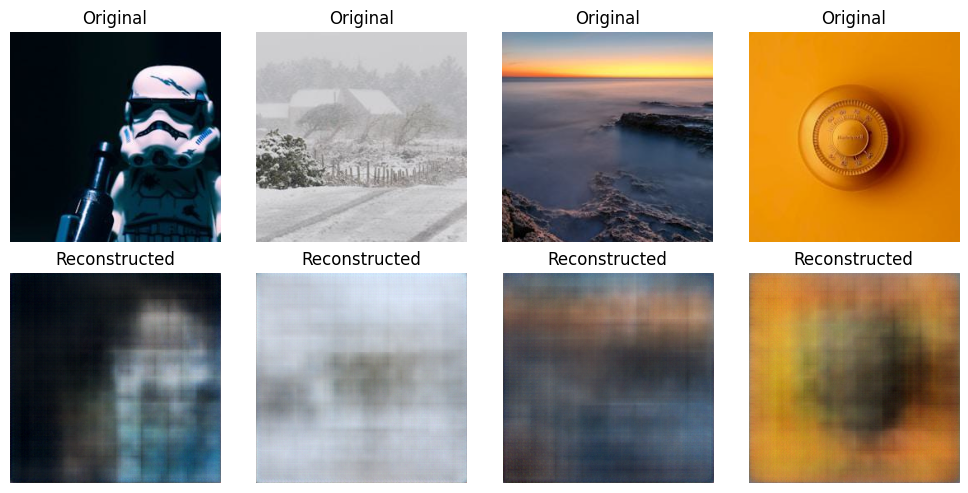

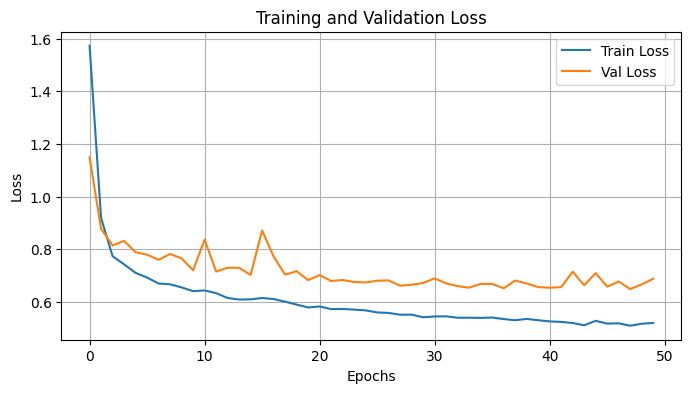

In [ ]:
decoder = Decoder()
train_decoder(resnet_feature_extractor, decoder, step1_train_loader, step1_val_loader,
              num_epochs=50, lr= 1e-4, save_every=10, save_path='./checkpoints_vanila_decoder_lr_1e-4')

In [ ]:
decoder = Decoder()
train_decoder(resnet_feature_extractor, decoder, step1_train_loader, step1_val_loader,
              num_epochs=300, lr= 1e-4, save_every=15, save_path='./checkpoints_vanila_decoder_lr_1e-4')

Using device: cuda
Epoch 1/300 | Train Loss: 1.3465 | Val Loss: 0.9848
Epoch 2/300 | Train Loss: 0.8509 | Val Loss: 0.9477
Epoch 3/300 | Train Loss: 0.7859 | Val Loss: 0.8282
Epoch 4/300 | Train Loss: 0.7390 | Val Loss: 0.7960
Epoch 5/300 | Train Loss: 0.7115 | Val Loss: 0.7997
Epoch 6/300 | Train Loss: 0.6957 | Val Loss: 0.7742
Epoch 7/300 | Train Loss: 0.6763 | Val Loss: 0.7649
Epoch 8/300 | Train Loss: 0.6649 | Val Loss: 0.7548
Epoch 9/300 | Train Loss: 0.6525 | Val Loss: 0.7429
Epoch 10/300 | Train Loss: 0.6417 | Val Loss: 0.7272
Epoch 11/300 | Train Loss: 0.6361 | Val Loss: 0.7238
Epoch 12/300 | Train Loss: 0.6311 | Val Loss: 0.7399


## Building Decoder 2 with Leaky Relu and Sigmoid in the end

- In train function, denomalize before calculating MSE Loss

In [ ]:
import torch.nn as nn

class LeakyDecoder(nn.Module):
    def __init__(self):
        super(LeakyDecoder, self).__init__()

        self.decoder = nn.Sequential(
            # Input: (512, 8, 8) → Output: (256, 16, 16)
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            # (256, 16, 16) → (128, 32, 32)
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            # (128, 32, 32) → (64, 64, 64)
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),

            # (64, 64, 64) → (32, 128, 128)
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),

            # (32, 128, 128) → (3, 256, 256)
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()  # squash pixel values to [0, 1]
        )

    def forward(self, x):
        return self.decoder(x)


In [ ]:
import time
import torch.optim as optim
import matplotlib.pyplot as plt


def train_decoder(encoder, decoder, train_loader, val_loader,
                 num_epochs=10, lr=1e-4, save_every=5, save_path='./checkpoints'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    start_time = time.time()

    print(f"Using device: {device}")
    encoder = encoder.to(device)
    decoder = decoder.to(device)

    # Define denormalization function
    def denormalize(tensor):
      """Denormalizes an image tensor.
      Input: (B, C, H, W) or (C, H, W)
      Output: Denormalized image tensor, same shape as input.
      """
      # get tensor device
      device = tensor.device
      mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
      std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
      return tensor * std + mean

    # Store fixed batch for visualization
    fixed_batch, _ = next(iter(val_loader))
    fixed_batch = fixed_batch[:4].to(device)

    # Freeze encoder
    for param in encoder.parameters():
        param.requires_grad = False
    encoder.eval()

    decoder.train()
    criterion = nn.L1Loss() # nn.MSELoss(), nn.L1Loss()
    optimizer = optim.Adam(decoder.parameters(), lr=lr, weight_decay=1e-6)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.5)

    os.makedirs(save_path, exist_ok=True)

    train_losses = []
    val_losses = []
    iters = []

    for epoch in range(num_epochs):
        total_train_loss = 0.0
        for imgs, _ in train_loader:
            imgs = imgs.to(device)
            with torch.no_grad():
                features = encoder(imgs)
            outputs = decoder(features)
            denorm_imgs = denormalize(imgs)
            loss = criterion(outputs, denorm_imgs)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()

        scheduler.step()

        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        # Validation loss
        decoder.eval()
        total_val_loss = 0.0
        with torch.no_grad():
            for imgs, _ in val_loader:
                imgs = imgs.to(device)
                features = encoder(imgs)
                outputs = decoder(features)
                denorm_imgs = denormalize(imgs)
                loss = criterion(outputs, denorm_imgs)
                total_val_loss += loss.item()
        decoder.train()

        avg_val_loss = total_val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        iters.append(epoch)

        print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

        # Save checkpoints and visualize
        if (epoch + 1) % save_every == 0:
            torch.save(decoder.state_dict(), os.path.join(save_path, f'decoder_epoch_{epoch+1}.pth'))

            # Visualize fixed batch
            with torch.no_grad():
                recon = decoder(encoder(fixed_batch))

            fig, axes = plt.subplots(2, 4, figsize=(10, 5))
            for i in range(4):
                # Original (denormalized)
                orig = denormalize(fixed_batch[i].cpu()).squeeze(0).permute(1, 2, 0).numpy()
                axes[0, i].imshow(orig.clip(0, 1))
                axes[0, i].set_title("Original")
                axes[0, i].axis('off')

                # Reconstruction (denormalized)
                recon_img = recon[i].cpu().permute(1, 2, 0).numpy()
                axes[1, i].imshow(recon_img.clip(0, 1))
                axes[1, i].set_title("Reconstructed")
                axes[1, i].axis('off')

            plt.tight_layout()
            plt.show()


    # time used for training
    print(f"Total training time: {time.time() - start_time:.2f} seconds")

    # Plot loss curve
    plt.figure(figsize=(8, 4))
    plt.plot(iters, train_losses, label='Train Loss')
    plt.plot(iters, val_losses, label='Val Loss')
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.legend()
    plt.grid(True)
    plt.show()

Using device: cuda
Epoch 1/100 | Train Loss: 0.0707 | Val Loss: 0.0504
Epoch 2/100 | Train Loss: 0.0447 | Val Loss: 0.0464
Epoch 3/100 | Train Loss: 0.0408 | Val Loss: 0.0426
Epoch 4/100 | Train Loss: 0.0382 | Val Loss: 0.0409
Epoch 5/100 | Train Loss: 0.0370 | Val Loss: 0.0404
Epoch 6/100 | Train Loss: 0.0360 | Val Loss: 0.0399
Epoch 7/100 | Train Loss: 0.0358 | Val Loss: 0.0395
Epoch 8/100 | Train Loss: 0.0348 | Val Loss: 0.0397
Epoch 9/100 | Train Loss: 0.0339 | Val Loss: 0.0379
Epoch 10/100 | Train Loss: 0.0336 | Val Loss: 0.0375


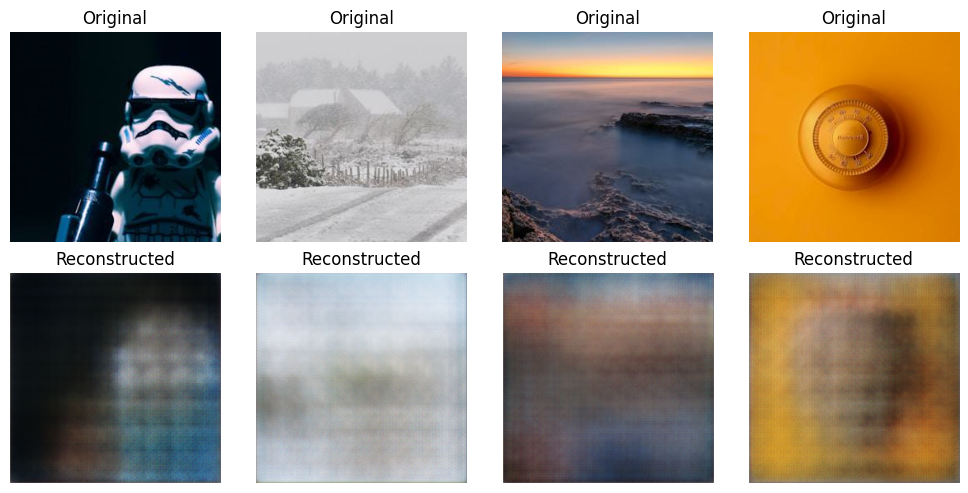

Epoch 11/100 | Train Loss: 0.0329 | Val Loss: 0.0383
Epoch 12/100 | Train Loss: 0.0324 | Val Loss: 0.0378
Epoch 13/100 | Train Loss: 0.0321 | Val Loss: 0.0377
Epoch 14/100 | Train Loss: 0.0320 | Val Loss: 0.0370
Epoch 15/100 | Train Loss: 0.0324 | Val Loss: 0.0369
Epoch 16/100 | Train Loss: 0.0316 | Val Loss: 0.0367
Epoch 17/100 | Train Loss: 0.0315 | Val Loss: 0.0361
Epoch 18/100 | Train Loss: 0.0316 | Val Loss: 0.0397
Epoch 19/100 | Train Loss: 0.0313 | Val Loss: 0.0356
Epoch 20/100 | Train Loss: 0.0309 | Val Loss: 0.0380


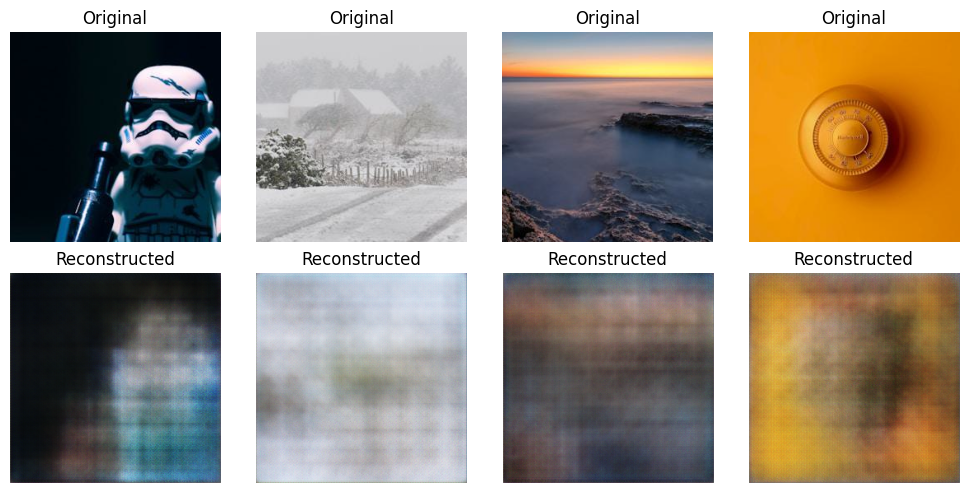

Epoch 21/100 | Train Loss: 0.0304 | Val Loss: 0.0354
Epoch 22/100 | Train Loss: 0.0300 | Val Loss: 0.0354
Epoch 23/100 | Train Loss: 0.0307 | Val Loss: 0.0357
Epoch 24/100 | Train Loss: 0.0300 | Val Loss: 0.0368
Epoch 25/100 | Train Loss: 0.0299 | Val Loss: 0.0350
Epoch 26/100 | Train Loss: 0.0301 | Val Loss: 0.0362
Epoch 27/100 | Train Loss: 0.0302 | Val Loss: 0.0350
Epoch 28/100 | Train Loss: 0.0300 | Val Loss: 0.0349
Epoch 29/100 | Train Loss: 0.0295 | Val Loss: 0.0349
Epoch 30/100 | Train Loss: 0.0297 | Val Loss: 0.0353


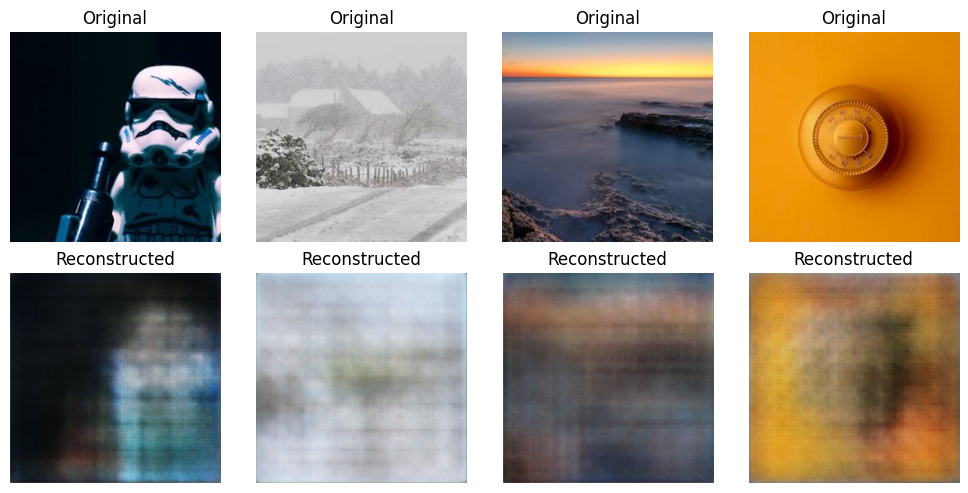

Epoch 31/100 | Train Loss: 0.0293 | Val Loss: 0.0349
Epoch 32/100 | Train Loss: 0.0291 | Val Loss: 0.0349
Epoch 33/100 | Train Loss: 0.0290 | Val Loss: 0.0346
Epoch 34/100 | Train Loss: 0.0296 | Val Loss: 0.0362
Epoch 35/100 | Train Loss: 0.0296 | Val Loss: 0.0357
Epoch 36/100 | Train Loss: 0.0287 | Val Loss: 0.0345
Epoch 37/100 | Train Loss: 0.0289 | Val Loss: 0.0351
Epoch 38/100 | Train Loss: 0.0292 | Val Loss: 0.0344
Epoch 39/100 | Train Loss: 0.0287 | Val Loss: 0.0343
Epoch 40/100 | Train Loss: 0.0288 | Val Loss: 0.0344


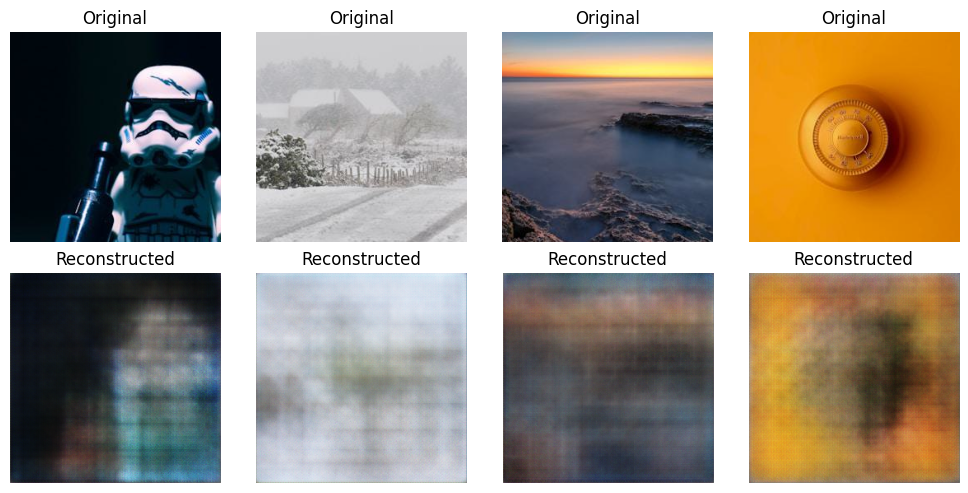

Epoch 41/100 | Train Loss: 0.0286 | Val Loss: 0.0342
Epoch 42/100 | Train Loss: 0.0287 | Val Loss: 0.0343
Epoch 43/100 | Train Loss: 0.0284 | Val Loss: 0.0343
Epoch 44/100 | Train Loss: 0.0290 | Val Loss: 0.0346
Epoch 45/100 | Train Loss: 0.0284 | Val Loss: 0.0342
Epoch 46/100 | Train Loss: 0.0286 | Val Loss: 0.0343
Epoch 47/100 | Train Loss: 0.0284 | Val Loss: 0.0342
Epoch 48/100 | Train Loss: 0.0284 | Val Loss: 0.0341
Epoch 49/100 | Train Loss: 0.0284 | Val Loss: 0.0342
Epoch 50/100 | Train Loss: 0.0283 | Val Loss: 0.0341


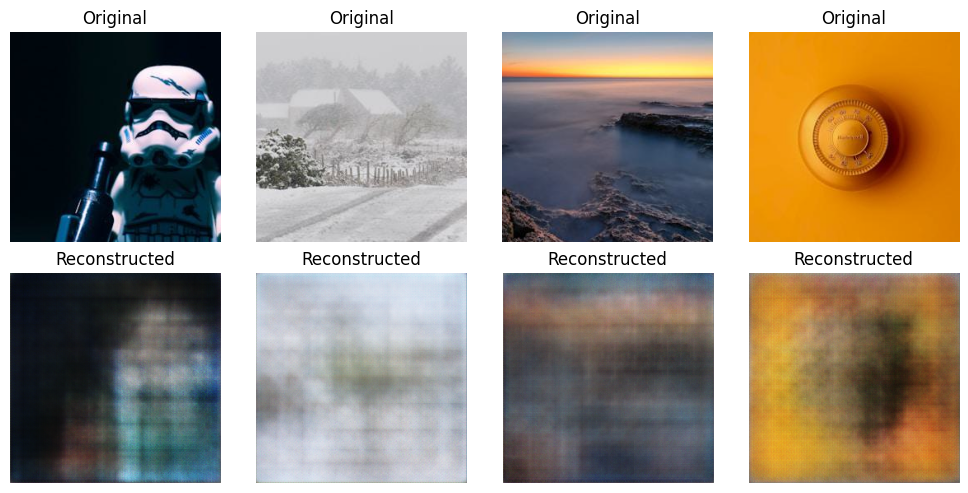

Epoch 51/100 | Train Loss: 0.0286 | Val Loss: 0.0341
Epoch 52/100 | Train Loss: 0.0284 | Val Loss: 0.0342
Epoch 53/100 | Train Loss: 0.0281 | Val Loss: 0.0341
Epoch 54/100 | Train Loss: 0.0283 | Val Loss: 0.0340
Epoch 55/100 | Train Loss: 0.0282 | Val Loss: 0.0342
Epoch 56/100 | Train Loss: 0.0282 | Val Loss: 0.0345
Epoch 57/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 58/100 | Train Loss: 0.0282 | Val Loss: 0.0343
Epoch 59/100 | Train Loss: 0.0285 | Val Loss: 0.0341
Epoch 60/100 | Train Loss: 0.0281 | Val Loss: 0.0340


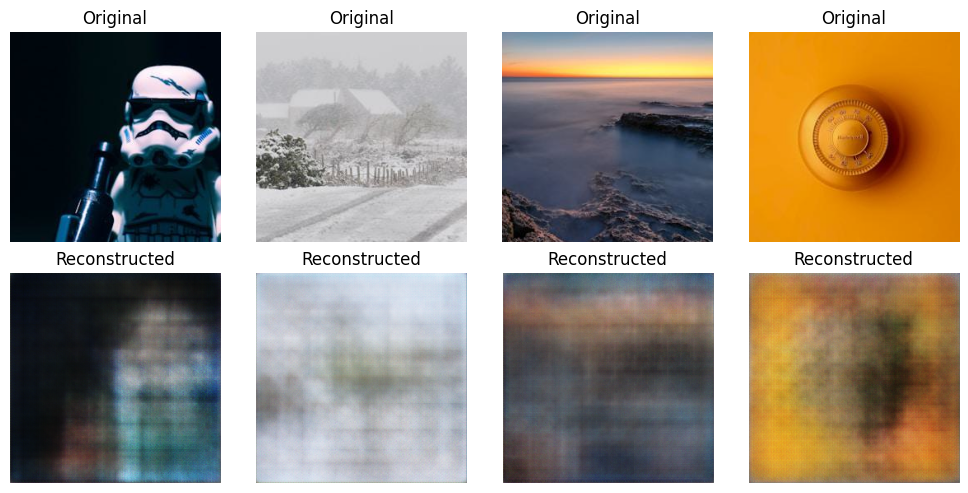

Epoch 61/100 | Train Loss: 0.0282 | Val Loss: 0.0342
Epoch 62/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 63/100 | Train Loss: 0.0281 | Val Loss: 0.0341
Epoch 64/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 65/100 | Train Loss: 0.0281 | Val Loss: 0.0342
Epoch 66/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 67/100 | Train Loss: 0.0281 | Val Loss: 0.0340
Epoch 68/100 | Train Loss: 0.0283 | Val Loss: 0.0340
Epoch 69/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 70/100 | Train Loss: 0.0280 | Val Loss: 0.0342


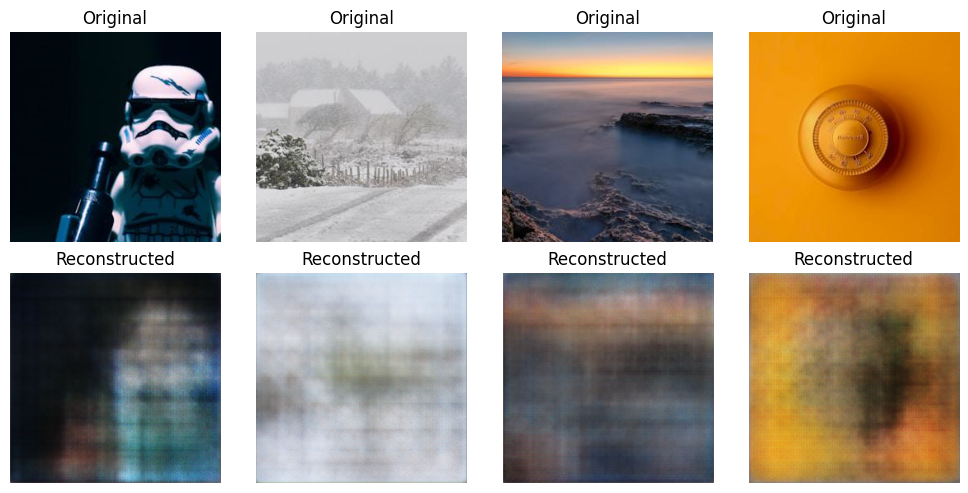

Epoch 71/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 72/100 | Train Loss: 0.0283 | Val Loss: 0.0341
Epoch 73/100 | Train Loss: 0.0280 | Val Loss: 0.0341
Epoch 74/100 | Train Loss: 0.0282 | Val Loss: 0.0341
Epoch 75/100 | Train Loss: 0.0282 | Val Loss: 0.0341
Epoch 76/100 | Train Loss: 0.0281 | Val Loss: 0.0340
Epoch 77/100 | Train Loss: 0.0281 | Val Loss: 0.0340
Epoch 78/100 | Train Loss: 0.0282 | Val Loss: 0.0341
Epoch 79/100 | Train Loss: 0.0280 | Val Loss: 0.0341
Epoch 80/100 | Train Loss: 0.0280 | Val Loss: 0.0340


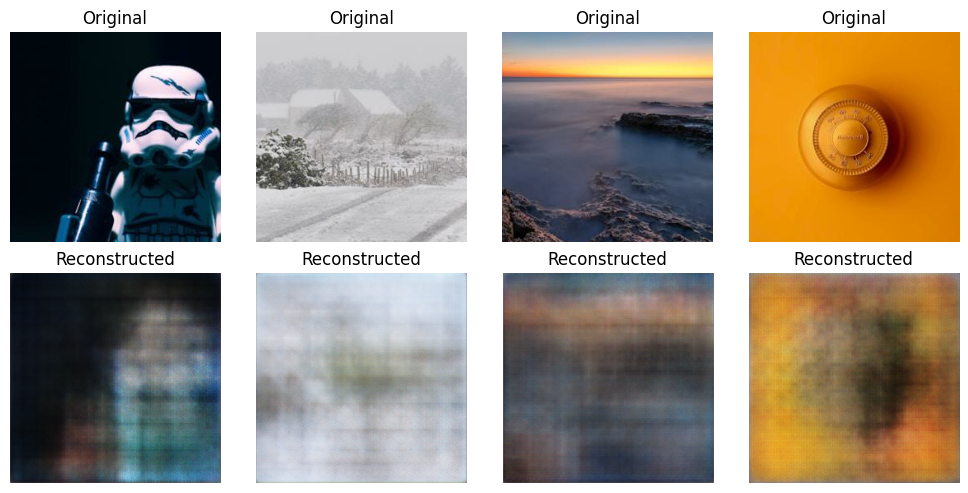

Epoch 81/100 | Train Loss: 0.0280 | Val Loss: 0.0340
Epoch 82/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 83/100 | Train Loss: 0.0281 | Val Loss: 0.0341
Epoch 84/100 | Train Loss: 0.0282 | Val Loss: 0.0341
Epoch 85/100 | Train Loss: 0.0281 | Val Loss: 0.0339
Epoch 86/100 | Train Loss: 0.0281 | Val Loss: 0.0339
Epoch 87/100 | Train Loss: 0.0280 | Val Loss: 0.0340
Epoch 88/100 | Train Loss: 0.0280 | Val Loss: 0.0339
Epoch 89/100 | Train Loss: 0.0279 | Val Loss: 0.0339
Epoch 90/100 | Train Loss: 0.0284 | Val Loss: 0.0340


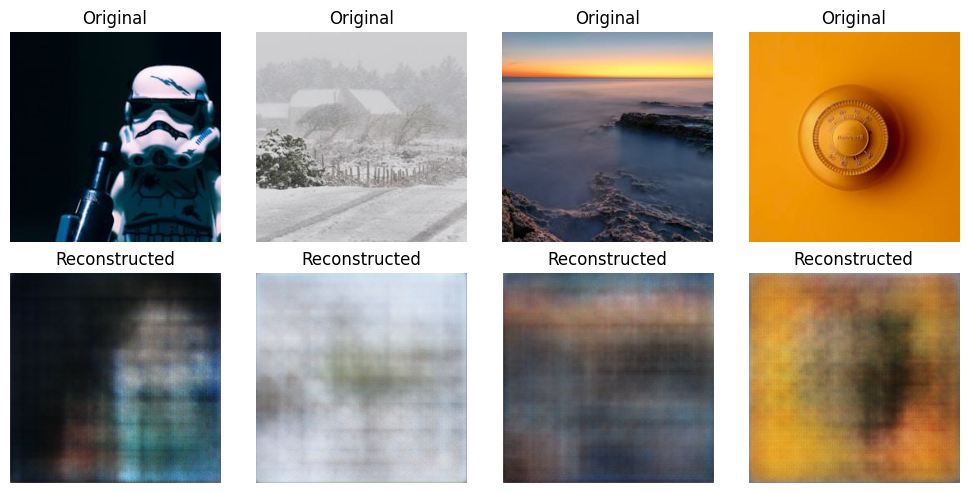

Epoch 91/100 | Train Loss: 0.0280 | Val Loss: 0.0341
Epoch 92/100 | Train Loss: 0.0281 | Val Loss: 0.0340
Epoch 93/100 | Train Loss: 0.0281 | Val Loss: 0.0340
Epoch 94/100 | Train Loss: 0.0282 | Val Loss: 0.0340
Epoch 95/100 | Train Loss: 0.0280 | Val Loss: 0.0340
Epoch 96/100 | Train Loss: 0.0280 | Val Loss: 0.0342
Epoch 97/100 | Train Loss: 0.0280 | Val Loss: 0.0339
Epoch 98/100 | Train Loss: 0.0279 | Val Loss: 0.0339
Epoch 99/100 | Train Loss: 0.0281 | Val Loss: 0.0340
Epoch 100/100 | Train Loss: 0.0280 | Val Loss: 0.0341


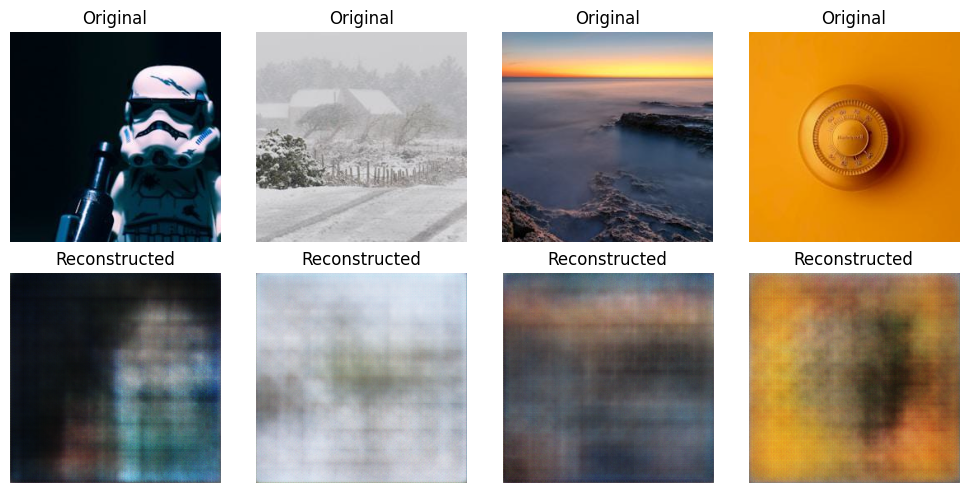

Total training time: 2188.86 seconds


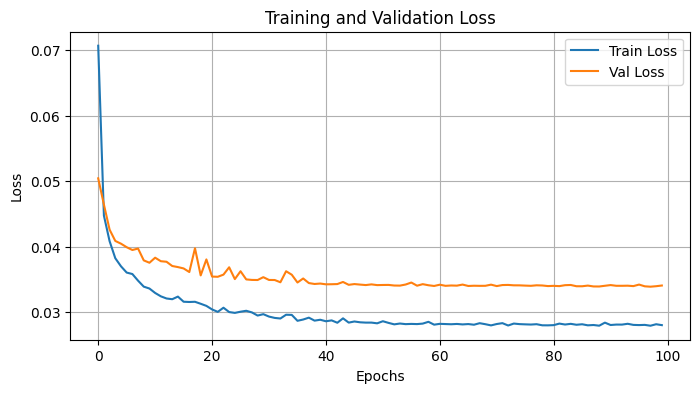

In [ ]:
leaky_decoder = LeakyDecoder()
train_decoder(encoder, leaky_decoder, step1_train_loader, step1_val_loader,
              num_epochs=100, lr=1e-4, save_every=10, save_path='./checkpoints_leakydecoder_1e-4')

### Try using L1Loss to train, see if we can get sharper image

Using device: cuda
Epoch 1/50 | Train Loss: 0.2132 | Val Loss: 0.1777
Epoch 2/50 | Train Loss: 0.1614 | Val Loss: 0.1695
Epoch 3/50 | Train Loss: 0.1500 | Val Loss: 0.1569
Epoch 4/50 | Train Loss: 0.1455 | Val Loss: 0.1534
Epoch 5/50 | Train Loss: 0.1422 | Val Loss: 0.1521
Epoch 6/50 | Train Loss: 0.1415 | Val Loss: 0.1528
Epoch 7/50 | Train Loss: 0.1407 | Val Loss: 0.1507
Epoch 8/50 | Train Loss: 0.1392 | Val Loss: 0.1476
Epoch 9/50 | Train Loss: 0.1367 | Val Loss: 0.1477
Epoch 10/50 | Train Loss: 0.1369 | Val Loss: 0.1476


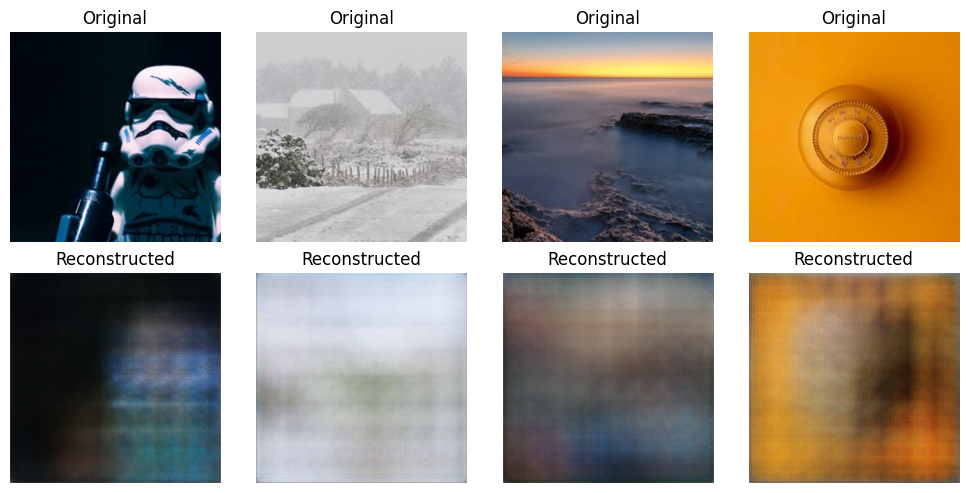

Epoch 11/50 | Train Loss: 0.1347 | Val Loss: 0.1450
Epoch 12/50 | Train Loss: 0.1342 | Val Loss: 0.1470
Epoch 13/50 | Train Loss: 0.1331 | Val Loss: 0.1440
Epoch 14/50 | Train Loss: 0.1325 | Val Loss: 0.1444
Epoch 15/50 | Train Loss: 0.1320 | Val Loss: 0.1448
Epoch 16/50 | Train Loss: 0.1314 | Val Loss: 0.1428
Epoch 17/50 | Train Loss: 0.1314 | Val Loss: 0.1426
Epoch 18/50 | Train Loss: 0.1312 | Val Loss: 0.1463
Epoch 19/50 | Train Loss: 0.1299 | Val Loss: 0.1430
Epoch 20/50 | Train Loss: 0.1291 | Val Loss: 0.1452


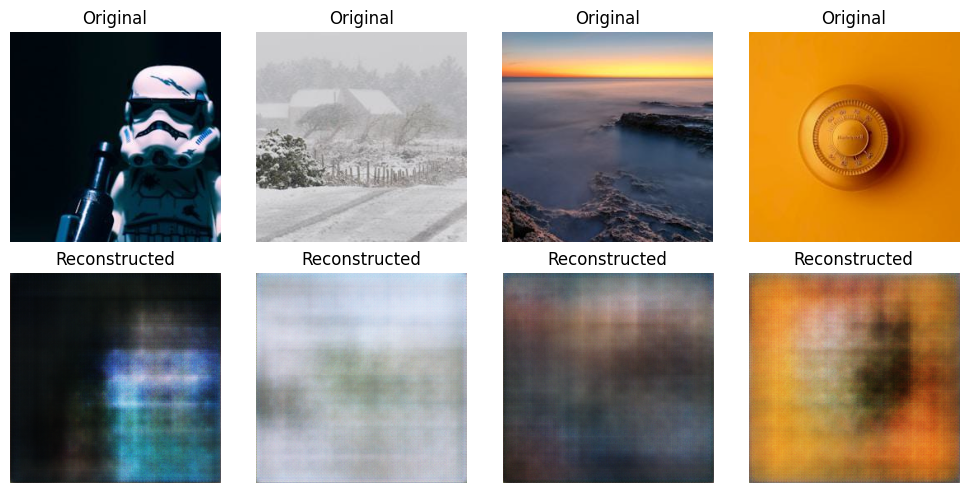

Epoch 21/50 | Train Loss: 0.1286 | Val Loss: 0.1407
Epoch 22/50 | Train Loss: 0.1283 | Val Loss: 0.1407
Epoch 23/50 | Train Loss: 0.1293 | Val Loss: 0.1424
Epoch 24/50 | Train Loss: 0.1281 | Val Loss: 0.1408
Epoch 25/50 | Train Loss: 0.1276 | Val Loss: 0.1406
Epoch 26/50 | Train Loss: 0.1277 | Val Loss: 0.1407
Epoch 27/50 | Train Loss: 0.1260 | Val Loss: 0.1401
Epoch 28/50 | Train Loss: 0.1267 | Val Loss: 0.1412
Epoch 29/50 | Train Loss: 0.1267 | Val Loss: 0.1401
Epoch 30/50 | Train Loss: 0.1257 | Val Loss: 0.1401


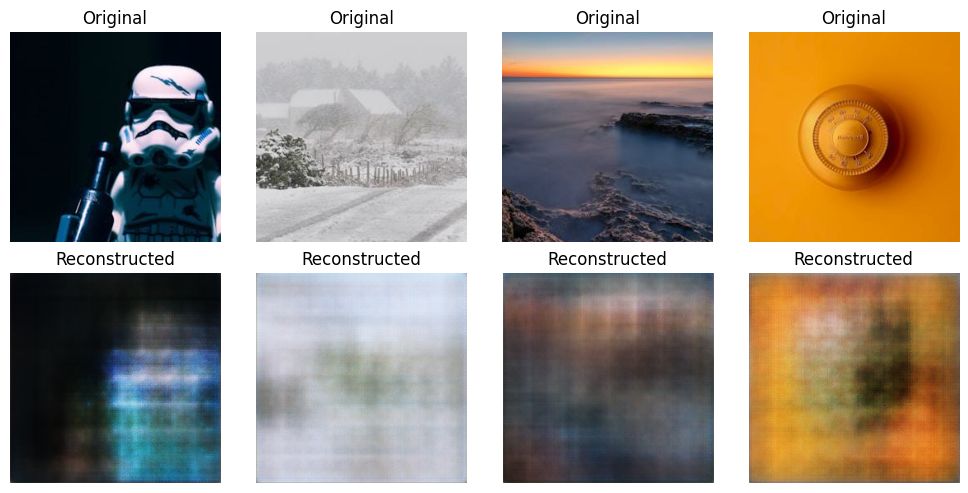

Epoch 31/50 | Train Loss: 0.1265 | Val Loss: 0.1420
Epoch 32/50 | Train Loss: 0.1259 | Val Loss: 0.1393
Epoch 33/50 | Train Loss: 0.1255 | Val Loss: 0.1398
Epoch 34/50 | Train Loss: 0.1251 | Val Loss: 0.1391
Epoch 35/50 | Train Loss: 0.1256 | Val Loss: 0.1389
Epoch 36/50 | Train Loss: 0.1252 | Val Loss: 0.1388
Epoch 37/50 | Train Loss: 0.1245 | Val Loss: 0.1388
Epoch 38/50 | Train Loss: 0.1247 | Val Loss: 0.1392
Epoch 39/50 | Train Loss: 0.1259 | Val Loss: 0.1407
Epoch 40/50 | Train Loss: 0.1244 | Val Loss: 0.1388


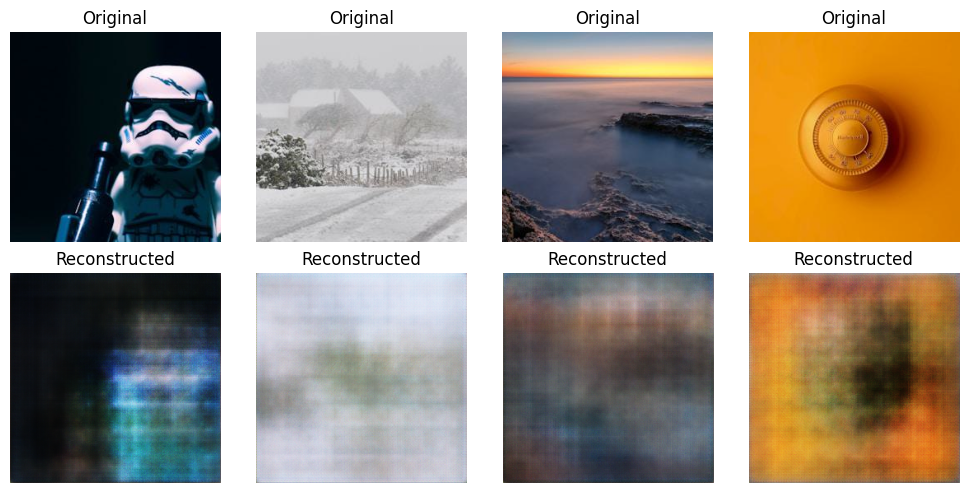

Epoch 41/50 | Train Loss: 0.1244 | Val Loss: 0.1383
Epoch 42/50 | Train Loss: 0.1252 | Val Loss: 0.1383
Epoch 43/50 | Train Loss: 0.1261 | Val Loss: 0.1389
Epoch 44/50 | Train Loss: 0.1248 | Val Loss: 0.1382
Epoch 45/50 | Train Loss: 0.1234 | Val Loss: 0.1383
Epoch 46/50 | Train Loss: 0.1248 | Val Loss: 0.1383
Epoch 47/50 | Train Loss: 0.1243 | Val Loss: 0.1381
Epoch 48/50 | Train Loss: 0.1238 | Val Loss: 0.1384
Epoch 49/50 | Train Loss: 0.1240 | Val Loss: 0.1390
Epoch 50/50 | Train Loss: 0.1236 | Val Loss: 0.1380


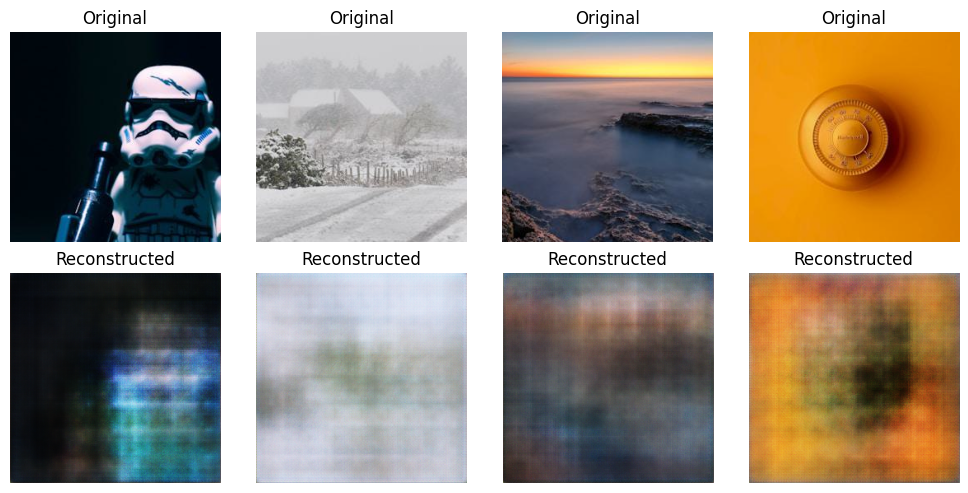

Total training time: 1105.55 seconds


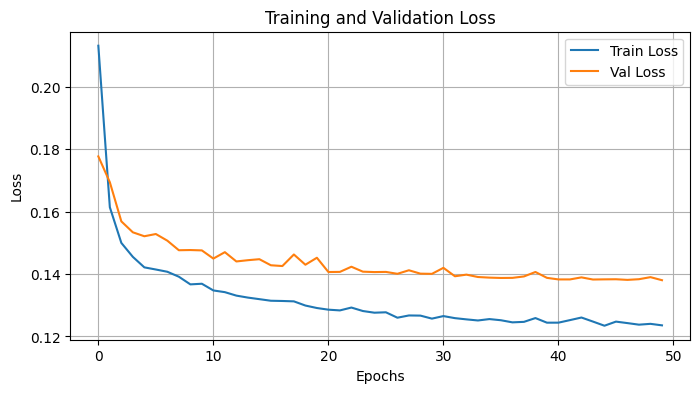

In [ ]:
l1_leaky_decoder = LeakyDecoder()
train_decoder(encoder, l1_leaky_decoder, step1_train_loader, step1_val_loader,
              num_epochs=50, lr=1e-4, save_every=10, save_path='checkpoints_l1_leaky')

# Sanity Check Between Step 1 and Step 2

Helper Functions for image potting

In [ ]:
import matplotlib.pyplot as plt

def get_plotting_samples(dataset, num_samples=4):
    """Get balanced samples for plotting (half real, half fake)"""
    # Get indices for each class
    real_indices = [i for i, (_, label) in enumerate(dataset) if label == 0]
    fake_indices = [i for i, (_, label) in enumerate(dataset) if label == 1]

    # Select equal numbers of each
    num_each = num_samples // 2
    selected_indices = real_indices[:num_each] + fake_indices[:num_each]

    # Get the actual samples
    samples = [dataset[i] for i in selected_indices]
    images = torch.stack([s[0] for s in samples])
    labels = torch.tensor([s[1] for s in samples])

    return images, labels

def get_plotting_samples_fast(dataset, num_samples=4):
    """Instant version - no image loading"""
    # Get all labels WITHOUT loading images
    labels = dataset.targets  # This exists for ImageFolder

    # Get indices for each class
    real_indices = [i for i, label in enumerate(labels) if label == 0]
    fake_indices = [i for i, label in enumerate(labels) if label == 1]

    # Select samples
    num_each = num_samples // 2
    selected_indices = real_indices[:num_each] + fake_indices[:num_each]

    # Only NOW load the specific images we need
    samples = [dataset[i] for i in selected_indices]
    return torch.stack([s[0] for s in samples]), torch.tensor([s[1] for s in samples])

torch.Size([1, 256, 256])
torch.Size([1, 256, 256])
torch.Size([1, 256, 256])
torch.Size([1, 256, 256])


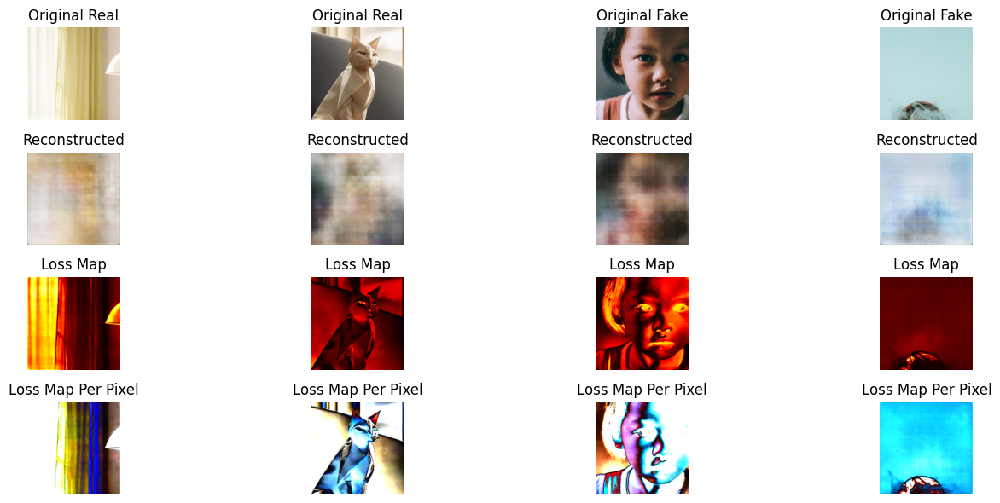

In [ ]:
import torch.nn.functional as F
# Define denormalization function
def denormalize(tensor):
  """Denormalizes an image tensor.
  Input: (B, C, H, W) or (C, H, W)
  Output: Denormalized image tensor, same shape as input.
  """
  mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).cpu()
  std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).cpu()
  return tensor * std + mean

def plot_reconstructions(encoder, decoder, images, labels):
    encoder.eval()
    decoder.eval()

    device = next(encoder.parameters()).device
    images = images.to(device)

    with torch.no_grad():
        reconstructions = decoder(encoder(images))

    fig, axes = plt.subplots(4, len(images), figsize=(15, 6))
    if len(images) == 1:
        axes = axes.reshape(2, 1)

    for i in range(len(images)):
        # Original
        orig = denormalize(images[i].cpu()).squeeze(0).permute(1, 2, 0).numpy()
        axes[0, i].imshow(orig.clip(0, 1))
        axes[0, i].set_title(f"Original {'Fake' if labels[i] else 'Real'}")
        axes[0, i].axis('off')

        # Reconstruction
        recon = reconstructions[i].cpu().squeeze(0).permute(1, 2, 0).numpy()
        axes[1, i].imshow(recon.clip(0, 1))
        axes[1, i].set_title("Reconstructed")
        axes[1, i].axis('off')

        # heap map for reconstrcution loss
        loss_map = F.mse_loss(reconstructions[i], images[i], reduction='none')  # shape: [B, C, H, W]
        loss_map_per_pixel = loss_map.mean(dim=0, keepdim=True)  # shape: [B, 1, H, W]
        print(loss_map_per_pixel.shape)
        axes[2, i].imshow(loss_map_per_pixel.permute(1,2,0), cmap='hot')
        axes[2, i].set_title("Loss Map")
        axes[2, i].axis('off')

        axes[3, i].imshow(loss_map.permute(1, 2, 0), cmap='hot')
        axes[3, i].set_title("Loss Map Per Pixel")
        axes[3, i].axis('off')



    plt.tight_layout()
    plt.show()

# plot 2 + 2
plot_images, plot_labels = get_plotting_samples_fast(val_dataset)
plot_reconstructions(encoder, leaky_decoder, plot_images, plot_labels)

### Load in checkpoints for the best model

In [ ]:
# load in checkpoints ofr leaky decoder
leaky_decoder = LeakyDecoder()
leaky_decoder.load_state_dict(torch.load('./checkpoints_leakydecoder_1e-4/decoder_epoch_100.pth'))

<All keys matched successfully>

# Step 2: Classifier based on Pixel-wise Loss

### Nathan Classifier

From Nathan,
- Change input dimension to B * 4 * 256 * 256
- add another layer in FC layers to reduce number of parameters

In [ ]:
import torch.nn as nn
import torch.nn.functional as F


# Based on baseline model
class CNNClassifier(nn.Module):
  def __init__(self):
    super(CNNClassifier, self).__init__()

    torch.manual_seed(42)

    # Name
    self.name = "cnnclassifier"

    # Activation
    self.activation = F.leaky_relu

    # Pooling
    self.maxpool2 = nn.MaxPool2d(kernel_size=2, stride=2)
    self.avgpool4 = nn.AvgPool2d(kernel_size=4, stride=4)
    self.global_avgpool = nn.AdaptiveAvgPool2d(1)  # New

    # Convolutional layers
    self.conv1 = nn.Conv2d(in_channels=4,
                           out_channels=64,
                           kernel_size=5, # new 7 - > 5
                           padding=2, # new 3 -> 2
                           stride=2)
    self.conv2 = nn.Conv2d(in_channels=64,
                           out_channels=64,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv3 = nn.Conv2d(in_channels=64,
                           out_channels=64,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv4 = nn.Conv2d(in_channels=64,
                           out_channels=128,
                           kernel_size=3,
                           padding=1,
                           stride=2)
    self.conv5 = nn.Conv2d(in_channels=128,
                           out_channels=128,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv6 = nn.Conv2d(in_channels=128,
                           out_channels=256,
                           kernel_size=3,
                           padding=1,
                           stride=2)
    self.conv7 = nn.Conv2d(in_channels=256,
                           out_channels=256,
                           kernel_size=3,
                           padding=1,
                           stride=1)

    self.conv8 = nn.Conv2d(in_channels=256,  # New layer
                              out_channels=512,
                              kernel_size=3,
                              padding=1,
                              stride=1)

    # FC layer (more efficient)
    self.fc = nn.Sequential(
        nn.Linear(512, 128),  # Reduced from 256*4*4
        nn.LeakyReLU(),
        nn.Linear(128, 1)
    )

    # Batch normalization
    self.norm64 = nn.BatchNorm2d(num_features=64)
    self.norm128 = nn.BatchNorm2d(num_features=128)
    self.norm256 = nn.BatchNorm2d(num_features=256)
    self.norm512 = nn.BatchNorm2d(num_features=512)  # New

  def forward(self, x):
    # Layer 1
    x = self.conv1(x)                                       # Output: 64x128x128
    x = self.norm64(self.activation(self.maxpool2(x)))      # Output: 64x64x64

    # Layer 2
    x = self.norm64(self.activation(self.conv2(x)))         # Output: 64x64x64

    # Layer 3
    x = self.norm64(self.activation(self.conv3(x)))         # Output: 64x64x64

    # Layer 4
    x = self.norm128(self.activation(self.conv4(x)))                        # Output: 128x32x32

    # Layer 5
    x = self.norm128(self.activation(self.conv5(x)))        # Output: 128x32x32

    # Layer 6
    x = self.norm256(self.activation(self.conv6(x)))        # Output: 256x16x16

    # Layer 7-8 (new)
    x = self.norm256(self.activation(self.conv7(x)))        # Output: 256x16x16
    x = self.norm512(self.activation(self.conv8(x)))        # Output: 512x16x16

    # Final Pooling  (new)
    x = self.global_avgpool(x)
    x = x.view(-1, 512)

    # Classification
    x = self.fc(x)
    x = x.squeeze(1)

    return x


cnn = CNNClassifier()
num_params = 0
for param in cnn.parameters():
    num_params += param.numel()
print("There are", num_params, "parameters in CNNClassifier")


There are 2434881 parameters in CNNClassifier


In [ ]:
dummy_input = torch.randn(1, 4, 256, 256)  # Batch of 1 RGB image
output = cnn(dummy_input)
print(output.shape)  # Should be [1]

torch.Size([1])


### Train Class

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import numpy as np

class EnhancedTrainer:
    def __init__(self, encoder, decoder, classifier, device='cuda'):
        self.encoder = encoder.eval().to(device)
        self.decoder = decoder.eval().to(device)
        self.classifier = classifier.to(device)
        self.device = device

        # Freeze encoder/decoder weights
        for param in self.encoder.parameters():
            param.requires_grad = False
        for param in self.decoder.parameters():
            param.requires_grad = False

        # Create checkpoint directory if it doesn't exist
        self.checkpoint_dir = f'./checkpoints_{self.classifier.name}/'
        os.makedirs(self.checkpoint_dir, exist_ok=True)

    def prepare_input(self, imgs):
        """Concatenate original images with their reconstruction loss maps"""
        with torch.no_grad():
            encoded = self.encoder(imgs)
            reconstructions = self.decoder(encoded)
            loss_maps = F.mse_loss(reconstructions, imgs, reduction='none').mean(dim=1, keepdim=True)
        return torch.cat([imgs, loss_maps], dim=1)  # [B, C+1, H, W]

    def train(self, train_loader, val_loader, num_epochs=30, lr=0.001, checkpoint_interval=10):
        optimizer = optim.Adam(self.classifier.parameters(), lr=lr, weight_decay=1e-5)
        criterion = nn.BCEWithLogitsLoss()

        train_losses, val_losses = [], []
        train_accs, val_accs = [], []

        for epoch in range(num_epochs):
            # Training phase
            self.classifier.train()
            epoch_loss, correct, total = 0, 0, 0

            for imgs, labels in train_loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)
                inputs = self.prepare_input(imgs)

                optimizer.zero_grad()
                outputs = self.classifier(inputs)
                loss = criterion(outputs, labels.float())
                loss.backward()
                optimizer.step()

                epoch_loss += loss.item()
                preds = (torch.sigmoid(outputs) > 0.5).long()
                correct += (preds.squeeze() == labels).sum().item()
                total += labels.size(0)

            train_losses.append(epoch_loss/len(train_loader))
            train_accs.append(correct/total)

            # Validation phase
            val_loss, val_acc = self.evaluate(val_loader)
            val_losses.append(val_loss)
            val_accs.append(val_acc)

            print(f'Epoch {epoch+1}/{num_epochs}: '
                  f'Train Loss: {train_losses[-1]:.4f}, Acc: {train_accs[-1]:.4f} | '
                  f'Val Loss: {val_loss:.4f}, Acc: {val_acc:.4f}')

            # Save checkpoint
            if (epoch+1) % checkpoint_interval == 0:
                if (epoch+1) % checkpoint_interval == 0:
                    checkpoint_path = os.path.join(
                        self.checkpoint_dir,
                        f'checkpoint_epoch{epoch+1}.pth'
                    )
                    torch.save(self.classifier.state_dict(), checkpoint_path)

        # Plot results
        self.plot_curves(train_losses, val_losses, train_accs, val_accs)

    def evaluate(self, loader):
        self.classifier.eval()
        criterion = nn.BCEWithLogitsLoss()
        total_loss, correct, total = 0, 0, 0

        with torch.no_grad():
            for imgs, labels in loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)
                inputs = self.prepare_input(imgs)
                outputs = self.classifier(inputs)

                total_loss += criterion(outputs, labels.float()).item()
                preds = (torch.sigmoid(outputs) > 0.5).long()
                correct += (preds.squeeze() == labels).sum().item()
                total += labels.size(0)

        return total_loss/len(loader), correct/total

    def plot_curves(self, train_loss, val_loss, train_acc, val_acc):
        plt.figure(figsize=(12, 5))

        plt.subplot(1, 2, 1)
        plt.plot(train_loss, label='Train')
        plt.plot(val_loss, label='Validation')
        plt.title('Loss Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()

        plt.subplot(1, 2, 2)
        plt.plot(train_acc, label='Train')
        plt.plot(val_acc, label='Validation')
        plt.title('Accuracy Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()

        plt.tight_layout()
        plt.show()

In [ ]:
# 1. Verify data loading
sample_batch = next(iter(train_loader))
print(f"Sample batch shapes - images: {sample_batch[0].shape}, labels: {sample_batch[1].shape}")


Sample batch shapes - images: torch.Size([64, 3, 256, 256]), labels: torch.Size([64])


cuda
Epoch 1/30: Train Loss: 0.4911, Acc: 0.7639 | Val Loss: 0.7303, Acc: 0.5101
Epoch 2/30: Train Loss: 0.4311, Acc: 0.8040 | Val Loss: 0.7776, Acc: 0.5027
Epoch 3/30: Train Loss: 0.1119, Acc: 0.9551 | Val Loss: 0.7153, Acc: 0.5121
Epoch 4/30: Train Loss: 0.0579, Acc: 0.9782 | Val Loss: 0.9527, Acc: 0.5000
Epoch 5/30: Train Loss: 0.0578, Acc: 0.9808 | Val Loss: 0.8218, Acc: 0.5000
Epoch 6/30: Train Loss: 0.0403, Acc: 0.9845 | Val Loss: 1.1123, Acc: 0.5000
Epoch 7/30: Train Loss: 0.0239, Acc: 0.9914 | Val Loss: 0.9063, Acc: 0.5000
Epoch 8/30: Train Loss: 0.0266, Acc: 0.9902 | Val Loss: 0.7069, Acc: 0.5027
Epoch 9/30: Train Loss: 0.0239, Acc: 0.9915 | Val Loss: 0.6358, Acc: 0.6992
Epoch 10/30: Train Loss: 0.0167, Acc: 0.9938 | Val Loss: 1.0037, Acc: 0.5030
Epoch 11/30: Train Loss: 0.0203, Acc: 0.9920 | Val Loss: 0.6155, Acc: 0.5972
Epoch 12/30: Train Loss: 0.0193, Acc: 0.9931 | Val Loss: 1.0109, Acc: 0.5067
Epoch 13/30: Train Loss: 0.0177, Acc: 0.9952 | Val Loss: 1.0072, Acc: 0.5158
Epo

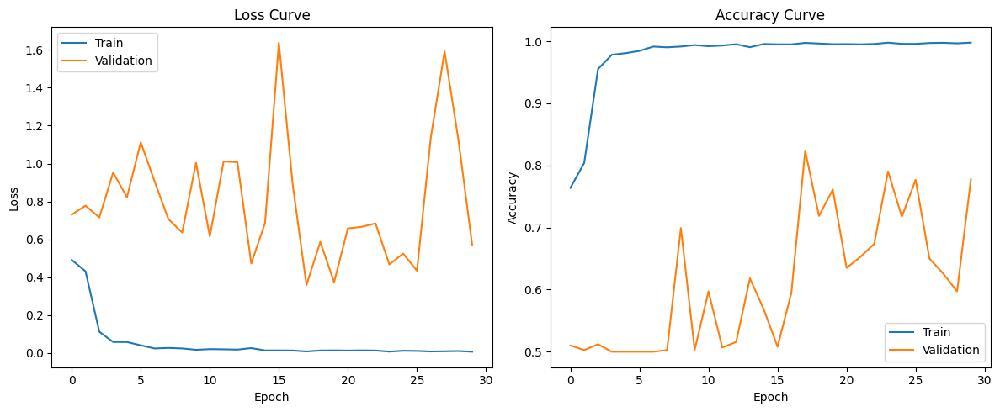

Total training time: 716.88 seconds


In [ ]:
import time
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)
start_time = time.time()
trainer = EnhancedTrainer(encoder, leaky_decoder, cnn, device)
trainer.train(train_loader, val_loader, num_epochs=30, lr=0.001)
train_time = time.time() - start_time
print(f"Total training time: {train_time:.2f} seconds")

cuda
Epoch 1/30: Train Loss: 0.6254, Acc: 0.6750 | Val Loss: 1.7504, Acc: 0.5000
Epoch 2/30: Train Loss: 0.5290, Acc: 0.7400 | Val Loss: 1.3624, Acc: 0.5000
Epoch 3/30: Train Loss: 0.4993, Acc: 0.7626 | Val Loss: 1.2611, Acc: 0.5000
Epoch 4/30: Train Loss: 0.4878, Acc: 0.7678 | Val Loss: 1.0771, Acc: 0.5000
Epoch 5/30: Train Loss: 0.4773, Acc: 0.7774 | Val Loss: 1.1105, Acc: 0.5000
Epoch 6/30: Train Loss: 0.4647, Acc: 0.7870 | Val Loss: 1.0437, Acc: 0.5000
Epoch 7/30: Train Loss: 0.4510, Acc: 0.7896 | Val Loss: 1.5626, Acc: 0.5000
Epoch 8/30: Train Loss: 0.4485, Acc: 0.7947 | Val Loss: 1.4255, Acc: 0.5000
Epoch 9/30: Train Loss: 0.4295, Acc: 0.8084 | Val Loss: 1.1363, Acc: 0.5000
Epoch 10/30: Train Loss: 0.4232, Acc: 0.8065 | Val Loss: 1.4681, Acc: 0.5000
Epoch 11/30: Train Loss: 0.4200, Acc: 0.8105 | Val Loss: 1.2412, Acc: 0.5000
Epoch 12/30: Train Loss: 0.4028, Acc: 0.8177 | Val Loss: 1.4465, Acc: 0.5013
Epoch 13/30: Train Loss: 0.4088, Acc: 0.8184 | Val Loss: 0.9895, Acc: 0.5081
Epo

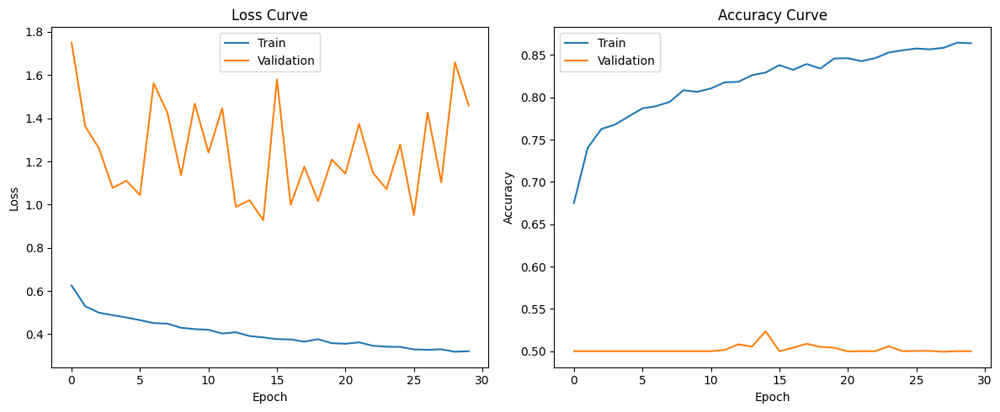

Total training time: 895.70 seconds


In [ ]:
# This runtime use train_loader with randomcrop
import time
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)
start_time = time.time()
trainer = EnhancedTrainer(encoder, leaky_decoder, cnn, device)
trainer.train(train_loader, val_loader, num_epochs=30, lr=0.001)
train_time = time.time() - start_time
print(f"Total training time: {train_time:.2f} seconds")

Okay it's definitely Guessing

### only passing in loss, not concatenate with original image

In [ ]:
import torch.nn as nn
import torch.nn.functional as F


# Based on baseline model
class MSEClassifier(nn.Module):
  def __init__(self):
    super(MSEClassifier, self).__init__()

    torch.manual_seed(42)

    # Name
    self.name = "mseclassifier"

    # Activation
    self.activation = F.leaky_relu

    # Pooling
    self.maxpool2 = nn.MaxPool2d(kernel_size=2, stride=2)
    self.avgpool4 = nn.AvgPool2d(kernel_size=4, stride=4)
    self.global_avgpool = nn.AdaptiveAvgPool2d(1)  # New

    # Convolutional layers
    self.conv1 = nn.Conv2d(in_channels=1,
                           out_channels=64,
                           kernel_size=5, # new 7 - > 5
                           padding=2, # new 3 -> 2
                           stride=2)
    self.conv2 = nn.Conv2d(in_channels=64,
                           out_channels=64,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv3 = nn.Conv2d(in_channels=64,
                           out_channels=64,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv4 = nn.Conv2d(in_channels=64,
                           out_channels=128,
                           kernel_size=3,
                           padding=1,
                           stride=2)
    self.conv5 = nn.Conv2d(in_channels=128,
                           out_channels=128,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv6 = nn.Conv2d(in_channels=128,
                           out_channels=256,
                           kernel_size=3,
                           padding=1,
                           stride=2)
    self.conv7 = nn.Conv2d(in_channels=256,
                           out_channels=256,
                           kernel_size=3,
                           padding=1,
                           stride=1)

    self.conv8 = nn.Conv2d(in_channels=256,  # New layer
                              out_channels=512,
                              kernel_size=3,
                              padding=1,
                              stride=1)

    # FC layer (more efficient)
    self.fc = nn.Sequential(
        nn.Linear(512, 128),  # Reduced from 256*4*4
        nn.LeakyReLU(),
        nn.Linear(128, 1)
    )

    # Batch normalization
    self.norm64 = nn.BatchNorm2d(num_features=64)
    self.norm128 = nn.BatchNorm2d(num_features=128)
    self.norm256 = nn.BatchNorm2d(num_features=256)
    self.norm512 = nn.BatchNorm2d(num_features=512)  # New

  def forward(self, x):
    # Layer 1
    x = self.conv1(x)                                       # Output: 64x128x128
    x = self.norm64(self.activation(self.maxpool2(x)))      # Output: 64x64x64

    # Layer 2
    x = self.norm64(self.activation(self.conv2(x)))         # Output: 64x64x64

    # Layer 3
    x = self.norm64(self.activation(self.conv3(x)))         # Output: 64x64x64

    # Layer 4
    x = self.norm128(self.activation(self.conv4(x)))                        # Output: 128x32x32

    # Layer 5
    x = self.norm128(self.activation(self.conv5(x)))        # Output: 128x32x32

    # Layer 6
    x = self.norm256(self.activation(self.conv6(x)))        # Output: 256x16x16

    # Layer 7-8 (new)
    x = self.norm256(self.activation(self.conv7(x)))        # Output: 256x16x16
    x = self.norm512(self.activation(self.conv8(x)))        # Output: 512x16x16

    # Final Pooling  (new)
    x = self.global_avgpool(x)
    x = x.view(-1, 512)

    # Classification
    x = self.fc(x)
    x = x.squeeze(1)

    return x


cnn = MSEClassifier()
num_params = 0
for param in cnn.parameters():
    num_params += param.numel()
print("There are", num_params, "parameters in MSEClassifier")


There are 2430081 parameters in MSEClassifier


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import numpy as np

class EnhancedTrainer:
    def __init__(self, encoder, decoder, classifier, device='cuda'):
        self.encoder = encoder.eval().to(device)
        self.decoder = decoder.eval().to(device)
        self.classifier = classifier.to(device)
        self.device = device

        # Freeze encoder/decoder weights
        for param in self.encoder.parameters():
            param.requires_grad = False
        for param in self.decoder.parameters():
            param.requires_grad = False

        # Create checkpoint directory if it doesn't exist
        self.checkpoint_dir = f'./checkpoints_{self.classifier.name}/'
        os.makedirs(self.checkpoint_dir, exist_ok=True)

    def prepare_input(self, imgs):
        """Concatenate original images with their reconstruction loss maps"""
        with torch.no_grad():
            encoded = self.encoder(imgs)
            reconstructions = self.decoder(encoded)
            loss_maps = F.mse_loss(reconstructions, imgs, reduction='none').mean(dim=1, keepdim=True)
        return loss_maps  # [B, 1, H, W]

    def train(self, train_loader, val_loader, num_epochs=30, lr=0.001, checkpoint_interval=10):
        optimizer = optim.Adam(self.classifier.parameters(), lr=lr, weight_decay=1e-5)
        criterion = nn.BCEWithLogitsLoss()

        train_losses, val_losses = [], []
        train_accs, val_accs = [], []

        for epoch in range(num_epochs):
            # Training phase
            self.classifier.train()
            epoch_loss, correct, total = 0, 0, 0

            for imgs, labels in train_loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)
                inputs = self.prepare_input(imgs)

                optimizer.zero_grad()
                outputs = self.classifier(inputs)
                loss = criterion(outputs, labels.float())
                loss.backward()
                optimizer.step()

                epoch_loss += loss.item()
                preds = (torch.sigmoid(outputs) > 0.5).long()
                correct += (preds.squeeze() == labels).sum().item()
                total += labels.size(0)

            train_losses.append(epoch_loss/len(train_loader))
            train_accs.append(correct/total)

            # Validation phase
            val_loss, val_acc = self.evaluate(val_loader)
            val_losses.append(val_loss)
            val_accs.append(val_acc)

            print(f'Epoch {epoch+1}/{num_epochs}: '
                  f'Train Loss: {train_losses[-1]:.4f}, Acc: {train_accs[-1]:.4f} | '
                  f'Val Loss: {val_loss:.4f}, Acc: {val_acc:.4f}')

            # Save checkpoint
            if (epoch+1) % checkpoint_interval == 0:
                if (epoch+1) % checkpoint_interval == 0:
                    checkpoint_path = os.path.join(
                        self.checkpoint_dir,
                        f'checkpoint_epoch{epoch+1}.pth'
                    )
                    torch.save(self.classifier.state_dict(), checkpoint_path)

        # Plot results
        self.plot_curves(train_losses, val_losses, train_accs, val_accs)

    def evaluate(self, loader):
        self.classifier.eval()
        criterion = nn.BCEWithLogitsLoss()
        total_loss, correct, total = 0, 0, 0

        with torch.no_grad():
            for imgs, labels in loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)
                inputs = self.prepare_input(imgs)
                outputs = self.classifier(inputs)

                total_loss += criterion(outputs, labels.float()).item()
                preds = (torch.sigmoid(outputs) > 0.5).long()
                correct += (preds.squeeze() == labels).sum().item()
                total += labels.size(0)

        return total_loss/len(loader), correct/total

    def plot_curves(self, train_loss, val_loss, train_acc, val_acc):
        plt.figure(figsize=(12, 5))

        plt.subplot(1, 2, 1)
        plt.plot(train_loss, label='Train')
        plt.plot(val_loss, label='Validation')
        plt.title('Loss Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()

        plt.subplot(1, 2, 2)
        plt.plot(train_acc, label='Train')
        plt.plot(val_acc, label='Validation')
        plt.title('Accuracy Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()

        plt.tight_layout()
        plt.show()

cuda
Epoch 1/30: Train Loss: 0.6116, Acc: 0.6699 | Val Loss: 0.8245, Acc: 0.5155
Epoch 2/30: Train Loss: 0.5486, Acc: 0.7278 | Val Loss: 1.5397, Acc: 0.5000
Epoch 3/30: Train Loss: 0.5079, Acc: 0.7517 | Val Loss: 1.8853, Acc: 0.5000
Epoch 4/30: Train Loss: 0.4886, Acc: 0.7675 | Val Loss: 0.9819, Acc: 0.5091
Epoch 5/30: Train Loss: 0.4749, Acc: 0.7784 | Val Loss: 2.4344, Acc: 0.5000
Epoch 6/30: Train Loss: 0.4559, Acc: 0.7862 | Val Loss: 1.2455, Acc: 0.4970
Epoch 7/30: Train Loss: 0.4510, Acc: 0.7885 | Val Loss: 1.0408, Acc: 0.5000
Epoch 8/30: Train Loss: 0.4333, Acc: 0.8028 | Val Loss: 1.9539, Acc: 0.4933
Epoch 9/30: Train Loss: 0.4268, Acc: 0.8056 | Val Loss: 1.3823, Acc: 0.5000
Epoch 10/30: Train Loss: 0.4196, Acc: 0.8117 | Val Loss: 1.7601, Acc: 0.5000
Epoch 11/30: Train Loss: 0.4111, Acc: 0.8162 | Val Loss: 1.6125, Acc: 0.5000
Epoch 12/30: Train Loss: 0.4037, Acc: 0.8224 | Val Loss: 1.6805, Acc: 0.5000
Epoch 13/30: Train Loss: 0.3975, Acc: 0.8228 | Val Loss: 1.2768, Acc: 0.5000
Epo

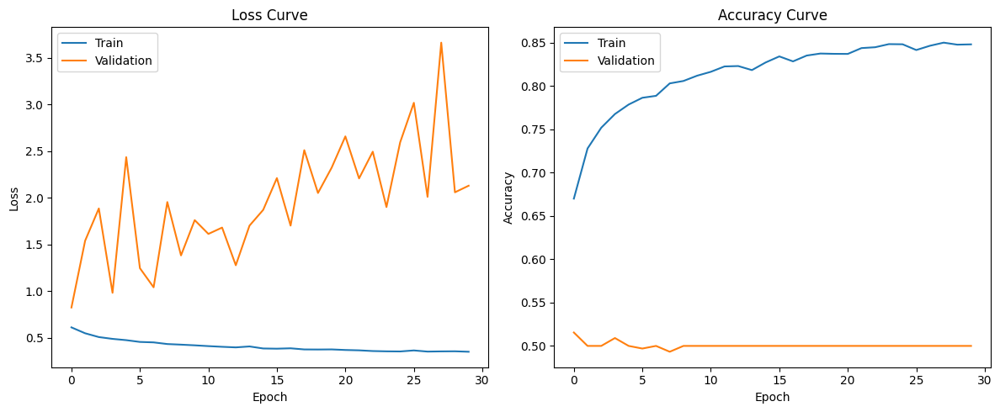

Total training time: 895.25 seconds


In [ ]:
# This runtime use train_loader with randomcrop
import time
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)
start_time = time.time()
trainer = EnhancedTrainer(encoder, leaky_decoder, cnn, device)
trainer.train(train_loader, val_loader, num_epochs=30, lr=0.001)
train_time = time.time() - start_time
print(f"Total training time: {train_time:.2f} seconds")

### Concatenate RECON with ORIGINAL

In [ ]:
import torch.nn as nn
import torch.nn.functional as F


# Based on baseline model
class ReconOrgClassifier(nn.Module):
  def __init__(self):
    super(ReconOrgClassifier, self).__init__()

    torch.manual_seed(42)

    # Name
    self.name = "roc"

    # Activation
    self.activation = F.leaky_relu

    # Pooling
    self.maxpool2 = nn.MaxPool2d(kernel_size=2, stride=2)
    self.avgpool4 = nn.AvgPool2d(kernel_size=4, stride=4)
    self.global_avgpool = nn.AdaptiveAvgPool2d(1)  # New

    # Convolutional layers
    self.conv1 = nn.Conv2d(in_channels=6,
                           out_channels=64,
                           kernel_size=5, # new 7 - > 5
                           padding=2, # new 3 -> 2
                           stride=2)
    self.conv2 = nn.Conv2d(in_channels=64,
                           out_channels=64,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv3 = nn.Conv2d(in_channels=64,
                           out_channels=64,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv4 = nn.Conv2d(in_channels=64,
                           out_channels=128,
                           kernel_size=3,
                           padding=1,
                           stride=2)
    self.conv5 = nn.Conv2d(in_channels=128,
                           out_channels=128,
                           kernel_size=3,
                           padding=1,
                           stride=1)
    self.conv6 = nn.Conv2d(in_channels=128,
                           out_channels=256,
                           kernel_size=3,
                           padding=1,
                           stride=2)
    self.conv7 = nn.Conv2d(in_channels=256,
                           out_channels=256,
                           kernel_size=3,
                           padding=1,
                           stride=1)

    self.conv8 = nn.Conv2d(in_channels=256,  # New layer
                              out_channels=512,
                              kernel_size=3,
                              padding=1,
                              stride=1)

    # FC layer (more efficient)
    self.fc = nn.Sequential(
        nn.Linear(512, 128),  # Reduced from 256*4*4
        nn.LeakyReLU(),
        nn.Linear(128, 1)
    )

    # Batch normalization
    self.norm64 = nn.BatchNorm2d(num_features=64)
    self.norm128 = nn.BatchNorm2d(num_features=128)
    self.norm256 = nn.BatchNorm2d(num_features=256)
    self.norm512 = nn.BatchNorm2d(num_features=512)  # New

  def forward(self, x):
    # Layer 1
    x = self.conv1(x)                                       # Output: 64x128x128
    x = self.norm64(self.activation(self.maxpool2(x)))      # Output: 64x64x64

    # Layer 2
    x = self.norm64(self.activation(self.conv2(x)))         # Output: 64x64x64

    # Layer 3
    x = self.norm64(self.activation(self.conv3(x)))         # Output: 64x64x64

    # Layer 4
    x = self.norm128(self.activation(self.conv4(x)))                        # Output: 128x32x32

    # Layer 5
    x = self.norm128(self.activation(self.conv5(x)))        # Output: 128x32x32

    # Layer 6
    x = self.norm256(self.activation(self.conv6(x)))        # Output: 256x16x16

    # Layer 7-8 (new)
    x = self.norm256(self.activation(self.conv7(x)))        # Output: 256x16x16
    x = self.norm512(self.activation(self.conv8(x)))        # Output: 512x16x16

    # Final Pooling  (new)
    x = self.global_avgpool(x)
    x = x.view(-1, 512)

    # Classification
    x = self.fc(x)
    x = x.squeeze(1)

    return x


roc = ReconOrgClassifier()
num_params = 0
for param in roc.parameters():
    num_params += param.numel()
print(f"There are {num_params} parameters in {roc.name}")


There are 2438081 parameters in roc


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import numpy as np

class EnhancedTrainer:
    def __init__(self, encoder, decoder, classifier, device='cuda'):
        self.encoder = encoder.eval().to(device)
        self.decoder = decoder.eval().to(device)
        self.classifier = classifier.to(device)
        self.device = device

        # Freeze encoder/decoder weights
        for param in self.encoder.parameters():
            param.requires_grad = False
        for param in self.decoder.parameters():
            param.requires_grad = False

        # Create checkpoint directory if it doesn't exist
        self.checkpoint_dir = f'./checkpoints_{self.classifier.name}/'
        os.makedirs(self.checkpoint_dir, exist_ok=True)

    def prepare_input(self, imgs):
      with torch.no_grad():
          reconstructions = self.decoder(self.encoder(imgs))
      return torch.cat([imgs, reconstructions], dim=1)  # Now both parts are normalized

    def train(self, train_loader, val_loader, num_epochs=30, lr=0.001, checkpoint_interval=10):
        optimizer = optim.Adam(self.classifier.parameters(), lr=lr, weight_decay=1e-5)
        criterion = nn.BCEWithLogitsLoss()

        train_losses, val_losses = [], []
        train_accs, val_accs = [], []

        for epoch in range(num_epochs):
            # Training phase
            self.classifier.train()
            epoch_loss, correct, total = 0, 0, 0

            for imgs, labels in train_loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)
                inputs = self.prepare_input(imgs)

                optimizer.zero_grad()
                outputs = self.classifier(inputs)
                loss = criterion(outputs, labels.float())
                loss.backward()
                optimizer.step()

                epoch_loss += loss.item()
                preds = (torch.sigmoid(outputs) > 0.5).long()
                correct += (preds.squeeze() == labels).sum().item()
                total += labels.size(0)

            train_losses.append(epoch_loss/len(train_loader))
            train_accs.append(correct/total)

            # Validation phase
            val_loss, val_acc = self.evaluate(val_loader)
            val_losses.append(val_loss)
            val_accs.append(val_acc)

            print(f'Epoch {epoch+1}/{num_epochs}: '
                  f'Train Loss: {train_losses[-1]:.4f}, Acc: {train_accs[-1]:.4f} | '
                  f'Val Loss: {val_loss:.4f}, Acc: {val_acc:.4f}')

            # Save checkpoint
            if (epoch+1) % checkpoint_interval == 0:
                if (epoch+1) % checkpoint_interval == 0:
                    checkpoint_path = os.path.join(
                        self.checkpoint_dir,
                        f'checkpoint_epoch{epoch+1}.pth'
                    )
                    torch.save(self.classifier.state_dict(), checkpoint_path)

        # Plot results
        self.plot_curves(train_losses, val_losses, train_accs, val_accs)

    def evaluate(self, loader):
        self.classifier.eval()
        criterion = nn.BCEWithLogitsLoss()
        total_loss, correct, total = 0, 0, 0

        with torch.no_grad():
            for imgs, labels in loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)
                inputs = self.prepare_input(imgs)
                outputs = self.classifier(inputs)

                total_loss += criterion(outputs, labels.float()).item()
                preds = (torch.sigmoid(outputs) > 0.5).long()
                correct += (preds.squeeze() == labels).sum().item()
                total += labels.size(0)

        return total_loss/len(loader), correct/total

    def plot_curves(self, train_loss, val_loss, train_acc, val_acc):
        plt.figure(figsize=(12, 5))

        plt.subplot(1, 2, 1)
        plt.plot(train_loss, label='Train')
        plt.plot(val_loss, label='Validation')
        plt.title('Loss Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()

        plt.subplot(1, 2, 2)
        plt.plot(train_acc, label='Train')
        plt.plot(val_acc, label='Validation')
        plt.title('Accuracy Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()

        plt.tight_layout()
        plt.show()

cuda
Epoch 1/30: Train Loss: 0.6148, Acc: 0.6645 | Val Loss: 1.5376, Acc: 0.5013
Epoch 2/30: Train Loss: 0.5832, Acc: 0.6934 | Val Loss: 0.7715, Acc: 0.5333
Epoch 3/30: Train Loss: 0.5535, Acc: 0.7206 | Val Loss: 0.7226, Acc: 0.6332
Epoch 4/30: Train Loss: 0.5425, Acc: 0.7331 | Val Loss: 0.8931, Acc: 0.5020
Epoch 5/30: Train Loss: 0.5339, Acc: 0.7381 | Val Loss: 0.6473, Acc: 0.6639
Epoch 6/30: Train Loss: 0.5197, Acc: 0.7441 | Val Loss: 0.7236, Acc: 0.5548
Epoch 7/30: Train Loss: 0.5026, Acc: 0.7569 | Val Loss: 1.2464, Acc: 0.5003
Epoch 8/30: Train Loss: 0.5039, Acc: 0.7600 | Val Loss: 0.8677, Acc: 0.5037
Epoch 9/30: Train Loss: 0.4841, Acc: 0.7741 | Val Loss: 1.1192, Acc: 0.5010
Epoch 10/30: Train Loss: 0.4765, Acc: 0.7714 | Val Loss: 1.0809, Acc: 0.5067
Epoch 11/30: Train Loss: 0.4692, Acc: 0.7824 | Val Loss: 0.8938, Acc: 0.5199
Epoch 12/30: Train Loss: 0.4632, Acc: 0.7855 | Val Loss: 1.0372, Acc: 0.5081
Epoch 13/30: Train Loss: 0.4606, Acc: 0.7864 | Val Loss: 1.3224, Acc: 0.5020
Epo

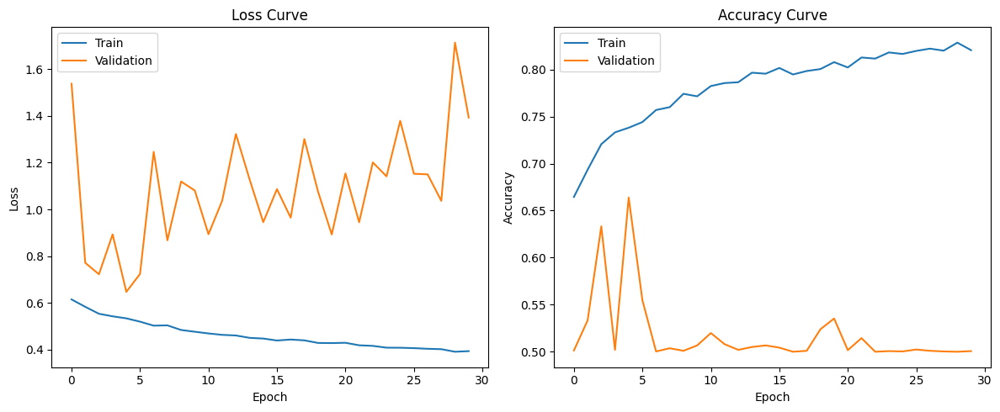

Total training time: 887.58 seconds


In [ ]:
# This runtime use train_loader with randomcrop
import time
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)
start_time = time.time()
roc = ReconOrgClassifier()
trainer = EnhancedTrainer(encoder, leaky_decoder, roc, device)
trainer.train(train_loader, val_loader, num_epochs=30, lr=0.001)
train_time = time.time() - start_time
print(f"Total training time: {train_time:.2f} seconds")


### normalize loss and times 3 times and concatenate

In [ ]:
class TNCTrainer(EnhancedTrainer): # Three times Normalized Concatenate
    def prepare_input(self, imgs):
        with torch.no_grad():
            reconstructions = self.decoder(self.encoder(imgs))
            loss_maps = F.mse_loss(reconstructions, imgs, reduction='none').mean(dim=1, keepdim=True)
            # normalize loss_maps
            loss_maps = (loss_maps - loss_maps.min()) / (loss_maps.max() - loss_maps.min())
            loss_maps = loss_maps * 3  # times 3
        return torch.cat([imgs, loss_maps], dim=1)

cuda
Epoch 1/30: Train Loss: 0.6142, Acc: 0.6656 | Val Loss: 0.7134, Acc: 0.5801
Epoch 2/30: Train Loss: 0.5716, Acc: 0.7112 | Val Loss: 0.9096, Acc: 0.5565
Epoch 3/30: Train Loss: 0.5509, Acc: 0.7206 | Val Loss: 0.6927, Acc: 0.6067
Epoch 4/30: Train Loss: 0.5279, Acc: 0.7435 | Val Loss: 0.7134, Acc: 0.5579
Epoch 5/30: Train Loss: 0.5060, Acc: 0.7529 | Val Loss: 1.0036, Acc: 0.5000
Epoch 6/30: Train Loss: 0.5024, Acc: 0.7559 | Val Loss: 0.8754, Acc: 0.5081
Epoch 7/30: Train Loss: 0.4960, Acc: 0.7635 | Val Loss: 0.7790, Acc: 0.5542
Epoch 8/30: Train Loss: 0.4832, Acc: 0.7725 | Val Loss: 0.8980, Acc: 0.5007
Epoch 9/30: Train Loss: 0.4795, Acc: 0.7711 | Val Loss: 0.8979, Acc: 0.5017
Epoch 10/30: Train Loss: 0.4678, Acc: 0.7818 | Val Loss: 1.2015, Acc: 0.5000
Epoch 11/30: Train Loss: 0.4695, Acc: 0.7820 | Val Loss: 0.9630, Acc: 0.5000
Epoch 12/30: Train Loss: 0.4561, Acc: 0.7904 | Val Loss: 1.0157, Acc: 0.5000
Epoch 13/30: Train Loss: 0.4559, Acc: 0.7916 | Val Loss: 0.9857, Acc: 0.5000
Epo

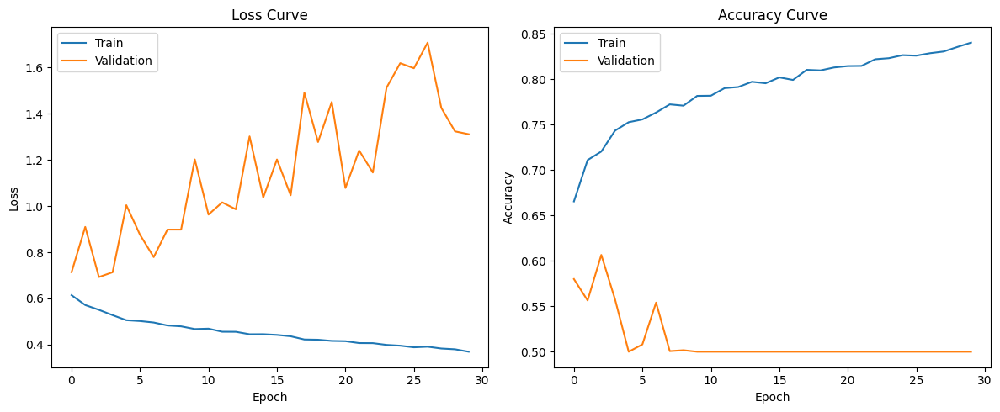

Total training time: 893.96 seconds


In [ ]:
# This runtime use train_loader with randomcrop
import time
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)
start_time = time.time()
tnc = CNNClassifier()
tnc.Name = "tnc"
trainer = TNCTrainer(encoder, leaky_decoder, tnc, device)
trainer.train(train_loader, val_loader, num_epochs=30, lr=0.001)
train_time = time.time() - start_time
print(f"Total training time: {train_time:.2f} seconds")


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ReconstructionLossClassifier(nn.Module):
    def __init__(self):
        super(ReconstructionLossClassifier, self).__init__()

        self.net = nn.Sequential(
            nn.Conv1d(in_channels=1, out_channels=8, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv1d(in_channels=8, out_channels=16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(16, 16),
            nn.ReLU(),
            nn.Linear(16, 1)  # binary classification: real vs fake
        )

    def forward(self, x):
        # x: [batch_size, 1, seq_len] — where seq_len is number of patches or pixel-wise loss
        return self.net(x)

real/
fake/

NAthan
1/
2/
3/

# Evaluation of Vedansh Transfer Learning

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import numpy as np
import os

In [2]:
from torchvision import models
import torch.nn as nn
# Load pre-trained ResNet18 (similar to AlexNet in the tutorial)
model = models.resnet18(pretrained=True)

# Freeze all parameters except the final layer (transfer learning)
for param in model.parameters():
    param.requires_grad = False

# Replace the final fully connected layer (custom classifier)
num_ftrs = model.fc.in_features
model.fc = nn.Sequential(
    nn.Linear(num_ftrs, 512),  # Fully connected layer
    nn.ReLU(),                 # Activation function
    nn.Dropout(0.5),           # Dropout for regularization
    nn.Linear(512, 1)          # Binary classification (real vs fake)
)



/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [17]:
# load best_model.pth
model.load_state_dict(torch.load('./best_model_now.pth', map_location=torch.device('cpu')))

<All keys matched successfully>

In [19]:
# evaluate this model
model.eval()
test_correct = 0
total = 0

with torch.no_grad():
    for inputs, labels in test_loader:

        outputs = model(inputs).squeeze()
        preds = torch.sigmoid(outputs) > 0.5
        test_correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f'Final Test Accuracy: {test_correct / total:.4f}')

Final Test Accuracy: 0.9180


In [20]:
# evaluate this model
model.eval()
test_correct = 0
total = 0

with torch.no_grad():
    for inputs, labels in new_step2_test_loader:

        outputs = model(inputs).squeeze()
        preds = torch.sigmoid(outputs) > 0.5
        test_correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f'Final Test Accuracy: {test_correct / total:.4f}')

Final Test Accuracy: 0.5820


# ViT + Efficient Net: Please work

### Sanity Precheck

In [14]:
import torch
import torch.nn as nn
from torchvision import models

# Load pretrained models (frozen)
vit = models.vit_b_16(pretrained=True)
efficientnet = models.efficientnet_b4(pretrained=True)

# Freeze weights
for param in vit.parameters():
    param.requires_grad = False
for param in efficientnet.parameters():
    param.requires_grad = False

# Remove classification heads
# nn.Identity() returns its input unchanged
vit.heads = nn.Identity()  # Outputs [CLS] token (768-dim)
efficientnet.classifier = nn.Identity()  # Outputs 1792-dim features


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ViT_B_16_Weights.IMAGENET1K_V1`. You can also use `weights=ViT_B_16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vit_b_16-c867db91.pth" to /root/.cache/torch/hub/checkpoints/vit_b_16-c867db91.pth
100%|██████████| 330M/330M [00:01<00:00, 191MB/s]
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in 

In [25]:
# For ViT
dummy_input = torch.randn(1, 3, 224, 224)
vit_features = vit(dummy_input)
print(vit_features.shape)  # Should be (1, 768)

# For EfficientNet
effnet_features = efficientnet(dummy_input)
print(effnet_features.shape)  # Should be (1, 1792)

torch.Size([1, 768])
torch.Size([1, 1792])


## Game Start

In [1]:
# mount our Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
cd /content/drive/MyDrive/Project 42/

/content/drive/MyDrive/Project 42


In [30]:
mkdir EfficientVit

mkdir: cannot create directory ‘EfficientVit’: File exists


In [3]:
cd EfficientVit

/content/drive/MyDrive/Project 42/EfficientVit


## Data Loaders

In [ ]:
!cp -r "/content/drive/MyDrive/Project 42/processedChameleon/step2" /content/step2

In [ ]:
!cp -r "/content/drive/MyDrive/Project 42/new_data_reduced/step2" /content/new_data_step2


In [37]:
import torch
import torch.nn as nn
from torchvision import models, transforms
from PIL import Image
import numpy as np
import os
from tqdm import tqdm

# Configuration
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
IMAGE_EXTS = ('.jpg', '.png', '.jpeg')

# Load models with caching
def load_models():
    vit = models.vit_b_16(pretrained=True)
    vit.heads = nn.Identity()

    effnet = models.efficientnet_b4(pretrained=True)
    effnet.classifier = nn.Identity()

    return vit.to(DEVICE).eval(), effnet.to(DEVICE).eval()

# Define transforms
vit_transform = transforms.Compose([
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5]*3, std=[0.5]*3)  # ViT
])

effnet_transform = transforms.Compose([
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # EfficientNet
])

def extract_embeddings(image_path, vit, effnet):
    """Robust embedding extraction with error handling"""
    try:
        img = Image.open(image_path).convert('RGB')
        vit_tensor = vit_transform(img).unsqueeze(0).to(DEVICE)
        effnet_tensor = effnet_transform(img).unsqueeze(0).to(DEVICE)

        with torch.no_grad():
            vit_emb = vit(vit_tensor).cpu().numpy().flatten()
            effnet_emb = effnet(effnet_tensor).cpu().numpy().flatten()

        return np.concatenate([vit_emb, effnet_emb])
    except Exception as e:
        print(f"Error processing {image_path}: {str(e)}")
        return None

def process_folder(image_dir, label, save_path="embeddings.npz"):
    """Process all images in folder/subfolders with single label"""
    vit, effnet = load_models()

    # Recursive image discovery
    image_paths = []
    for root, _, files in os.walk(image_dir):
        image_paths.extend(
            os.path.join(root, f)
            for f in files
            if f.lower().endswith(IMAGE_EXTS)
        )

    if not image_paths:
        raise ValueError(f"No images found in {image_dir}")

    # Process with progress bar
    embeddings = []
    successful_paths = []

    for path in tqdm(image_paths, desc="🔄 Processing images"):
        emb = extract_embeddings(path, vit, effnet)
        if emb is not None:
            embeddings.append(emb)
            successful_paths.append(path)

    # Prepare save data
    save_data = {
        'embeddings': np.array(embeddings),
        'label': np.full(len(embeddings), label)  # Single label for all
    }

    # Ensure output directory exists
    os.makedirs(os.path.dirname(save_path) if os.path.dirname(save_path) else None, exist_ok=True)

    # Save all data
    np.savez_compressed(save_path, **save_data)
    print(f"Saved {len(embeddings)} embeddings to {save_path}")
    print(f"  - Label: {label} (applied to all images)")
    print(f"  - Failed: {len(image_paths) - len(embeddings)} images")

In [38]:
process_folder(
    image_dir="/content/drive/MyDrive/Project 42/new_data_reduced/step2/test/real",
    label = 0,  # 0 for real, 1 for fake
    save_path="embeddings/test/real_embeddings.npz"
)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ViT_B_16_Weights.IMAGENET1K_V1`. You can also use `weights=ViT_B_16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most u

Saved 413 embeddings to embeddings/test/real_embeddings.npz
  - Label: 0 (applied to all images)
  - Failed: 0 images


In [39]:
base_dir = "/content/drive/MyDrive/Project 42/new_data_reduced/step2"
datasets = [
    #("test/fake", 1, "test_fake.npz"),
    #("test/real", 0, "test_real.npz"),
    ("train/fake", 1, "train_fake.npz"),
    ("train/real", 0, "train_real.npz"),
    ("val/fake", 1, "val_fake.npz"),
    ("val/real", 0, "val_real.npz"),
]

for rel_path, label, filename in datasets:
    process_folder(
        image_dir=os.path.join(base_dir, rel_path),
        label=label,
        save_path=os.path.join("embeddings", filename)
    )

🔄 Processing images: 100%|██████████| 360/360 [01:55<00:00,  3.13it/s]


Saved 360 embeddings to embeddings/test_fake.npz
  - Label: 1 (applied to all images)
  - Failed: 0 images


🔄 Processing images: 100%|██████████| 8177/8177 [57:49<00:00,  2.36it/s]


Saved 8177 embeddings to embeddings/train_fake.npz
  - Label: 1 (applied to all images)
  - Failed: 0 images


🔄 Processing images: 100%|██████████| 5826/5826 [31:39<00:00,  3.07it/s]


Saved 5826 embeddings to embeddings/train_real.npz
  - Label: 0 (applied to all images)
  - Failed: 0 images


🔄 Processing images: 100%|██████████| 3607/3607 [28:48<00:00,  2.09it/s]


Saved 3607 embeddings to embeddings/val_fake.npz
  - Label: 1 (applied to all images)
  - Failed: 0 images


🔄 Processing images: 100%|██████████| 1621/1621 [08:29<00:00,  3.18it/s]


Saved 1621 embeddings to embeddings/val_real.npz
  - Label: 0 (applied to all images)
  - Failed: 0 images


# Balance the data

In [12]:
import numpy as np
import torch
from torch.utils.data import DataLoader, WeightedRandomSampler, TensorDataset

# Configuration
BATCH_SIZE = 32
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

# 1. Load all your .npz files
print("Loading embeddings...")
train_fake = np.load('embeddings/train_fake.npz')['embeddings']
train_real = np.load('embeddings/train_real.npz')['embeddings']
val_fake = np.load('embeddings/val_fake.npz')['embeddings']
val_real = np.load('embeddings/val_real.npz')['embeddings']

# 2. Create labels (1=fake, 0=real) and combine
print("Combining datasets...")
X_train = np.concatenate([train_fake, train_real])
y_train = np.concatenate([np.ones(len(train_fake), dtype=int), np.zeros(len(train_real), dtype=int)])

min_len = min(len(val_fake), len(val_real))

X_val = np.concatenate([
    val_fake[:min_len],
    val_real[:min_len]
])
y_val = np.concatenate([
    np.ones(min_len, dtype=int),
    np.zeros(min_len, dtype=int)
])


# 3. Convert to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val, dtype=torch.long)

# 4. Create balanced sampler for training
print("⚖️ Balancing classes...")
class_counts = np.bincount(y_train)
class_weights = 1. / class_counts
sample_weights = class_weights[y_train]

sampler = WeightedRandomSampler(
    weights=sample_weights,
    num_samples=len(sample_weights),
    replacement=True
)

# 5. Create DataLoaders
print("📦 Creating DataLoaders...")
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    sampler=sampler,
    pin_memory=True,
    num_workers=2
)

val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    pin_memory=True,
    num_workers=2
)

# 6. Verify the balance
def check_balance(loader, name):
    y = []
    for _, labels in loader:
        y.extend(labels.numpy())
    print(f"{name} balance: {np.bincount(y)} (0=real, 1=fake)")

check_balance(train_loader, "Train")
check_balance(val_loader, "Validation")

print("✅ Data loaders ready!")
print(f"Train batches: {len(train_loader)} ({len(train_dataset)} samples)")
print(f"Val batches: {len(val_loader)} ({len(val_dataset)} samples)")

Loading embeddings...
Combining datasets...
⚖️ Balancing classes...
📦 Creating DataLoaders...
Train balance: [6961 7042] (0=real, 1=fake)
Validation balance: [1621 1621] (0=real, 1=fake)
✅ Data loaders ready!
Train batches: 438 (14003 samples)
Val batches: 102 (3242 samples)


In [16]:
# Combined model
class MultiExpertDetector(nn.Module):
    def __init__(self):
        super().__init__()
        self.name = "EfficientVit"
        self.vit = vit
        self.efficientnet = efficientnet
        self.classifier = nn.Sequential(
            nn.Linear(768 + 1792, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 1)
        )

    def forward(self, x):
        # Preprocess for ViT and EfficientNet separately if needed
        vit_features = self.vit(x)  # Global features
        effnet_features = self.efficientnet(x)  # Local features
        combined = torch.cat([vit_features, effnet_features], dim=1)
        return self.classifier(combined)

model = MultiExpertDetector()

In [66]:
class EmbeddingClassifier(nn.Module):
    def __init__(self, input_dim=768+1792):
        super().__init__()
        self.name = "EmbeddingClassifier"
        self.classifier = nn.Sequential(
            nn.Linear(input_dim, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 1)
        )

    def forward(self, x):
        return self.classifier(x)


## Trainer

In [18]:
import torch
import torch.nn as nn
import torch.optim as optim
import os
import matplotlib.pyplot as plt
import torch.nn.functional as F

class MultiExpertTrainer:
    def __init__(self, model, device='cuda'):
        self.model = model.to(device)
        self.device = device
        self.checkpoint_dir = f'./checkpoints_{self.model.name}/'
        os.makedirs(self.checkpoint_dir, exist_ok=True)

    def train(self, train_loader, val_loader, num_epochs=30, lr=0.001, checkpoint_interval=10):
        optimizer = optim.Adam(self.model.parameters(), lr=lr, weight_decay=1e-5)
        criterion = nn.BCEWithLogitsLoss()

        train_losses, val_losses = [], []
        train_accs, val_accs = [], []

        for epoch in range(num_epochs):
            self.model.train()
            epoch_loss, correct, total = 0, 0, 0

            for imgs, labels in train_loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)

                optimizer.zero_grad()
                outputs = self.model(imgs)
                loss = criterion(outputs.squeeze(), labels.float())
                loss.backward()
                optimizer.step()

                epoch_loss += loss.item()
                preds = (torch.sigmoid(outputs.squeeze()) > 0.5).long()
                correct += (preds == labels).sum().item()
                total += labels.size(0)

            train_losses.append(epoch_loss / len(train_loader))
            train_accs.append(correct / total)

            val_loss, val_acc = self.evaluate(val_loader)
            val_losses.append(val_loss)
            val_accs.append(val_acc)

            print(f'Epoch {epoch+1}/{num_epochs}: '
                  f'Train Loss: {train_losses[-1]:.4f}, Acc: {train_accs[-1]:.4f} | '
                  f'Val Loss: {val_loss:.4f}, Acc: {val_acc:.4f}')

            if (epoch + 1) % checkpoint_interval == 0:
                torch.save(self.model.state_dict(),
                           os.path.join(self.checkpoint_dir, f'checkpoint_epoch{epoch+1}.pth'))

        self.plot_curves(train_losses, val_losses, train_accs, val_accs)

    def evaluate(self, loader):
        self.model.eval()
        criterion = nn.BCEWithLogitsLoss()
        total_loss, correct, total = 0, 0, 0

        with torch.no_grad():
            for imgs, labels in loader:
                imgs, labels = imgs.to(self.device), labels.to(self.device)
                outputs = self.model(imgs)

                total_loss += criterion(outputs.squeeze(), labels.float()).item()
                preds = (torch.sigmoid(outputs.squeeze()) > 0.5).long()
                correct += (preds == labels).sum().item()
                total += labels.size(0)

        return total_loss / len(loader), correct / total

    def plot_curves(self, train_loss, val_loss, train_acc, val_acc):
        plt.figure(figsize=(8, 3))

        plt.subplot(1, 2, 1)
        plt.plot(train_loss, label='Train')
        plt.plot(val_loss, label='Validation')
        plt.title('Loss Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()

        plt.subplot(1, 2, 2)
        plt.plot(train_acc, label='Train')
        plt.plot(val_acc, label='Validation')
        plt.title('Accuracy Curve')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()

        plt.tight_layout()
        plt.show()


cuda
Epoch 1/30: Train Loss: 0.6459, Acc: 0.6729 | Val Loss: 0.6054, Acc: 0.7631
Epoch 2/30: Train Loss: 0.5686, Acc: 0.7580 | Val Loss: 0.5297, Acc: 0.8220
Epoch 3/30: Train Loss: 0.5194, Acc: 0.7878 | Val Loss: 0.4725, Acc: 0.8467
Epoch 4/30: Train Loss: 0.4731, Acc: 0.8068 | Val Loss: 0.4270, Acc: 0.8593
Epoch 5/30: Train Loss: 0.4471, Acc: 0.8185 | Val Loss: 0.3974, Acc: 0.8661
Epoch 6/30: Train Loss: 0.4212, Acc: 0.8274 | Val Loss: 0.3769, Acc: 0.8661
Epoch 7/30: Train Loss: 0.4038, Acc: 0.8324 | Val Loss: 0.3597, Acc: 0.8701
Epoch 8/30: Train Loss: 0.3883, Acc: 0.8385 | Val Loss: 0.3454, Acc: 0.8708
Epoch 9/30: Train Loss: 0.3795, Acc: 0.8397 | Val Loss: 0.3377, Acc: 0.8708
Epoch 10/30: Train Loss: 0.3655, Acc: 0.8467 | Val Loss: 0.3295, Acc: 0.8708
Epoch 11/30: Train Loss: 0.3609, Acc: 0.8459 | Val Loss: 0.3237, Acc: 0.8735
Epoch 12/30: Train Loss: 0.3551, Acc: 0.8488 | Val Loss: 0.3193, Acc: 0.8751
Epoch 13/30: Train Loss: 0.3427, Acc: 0.8541 | Val Loss: 0.3155, Acc: 0.8729
Epo

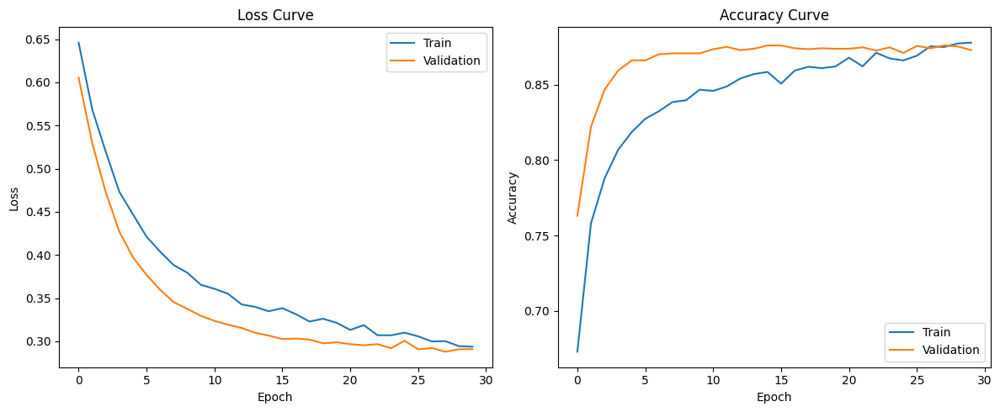

Time taken: 42.41617941856384 seconds


In [22]:
import time
start = time.time()
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

model = EmbeddingClassifier()
trainer = MultiExpertTrainer(model=model, device=device)

trainer.train(
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=30,
    lr=1e-5,
    checkpoint_interval=3
)

end = time.time()
print(f"Time taken: {end - start} seconds")

##3 Test Loader

In [73]:
# test accuracy

import numpy as np
import torch
from torch.utils.data import DataLoader, TensorDataset

print("Loading test embeddings...")
test_fake = np.load('embeddings/test_fake.npz')['embeddings']
test_real = np.load('embeddings/test_real.npz')['embeddings']

print("Combining test datasets...")
X_test = np.concatenate([test_fake, test_real])
y_test = np.concatenate([
    np.ones(len(test_fake), dtype=int),
    np.zeros(len(test_real), dtype=int)
])

X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.long)


Loading test embeddings...
Combining test datasets...
Test loader ready: 24 batches (773 samples)


In [77]:
embedding_test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
embedding_test_loader = DataLoader(
    embedding_test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    pin_memory=True,
    num_workers=2
)

print(f"Test loader ready: {len(embedding_test_loader)} batches ({len(embedding_test_dataset)} samples)")


Test loader ready: 25 batches (773 samples)


In [78]:
sum = 0
for imgs, labels in embedding_test_loader:
    sum += len(imgs)
print(sum)


773


In [59]:
model = EmbeddingClassifier()
model.load_state_dict(torch.load('./checkpoints_EmbeddingClassifier/checkpoint_epoch30.pth'))
model.eval()
model = model.to(device)

In [79]:
def print_accuracy_from_embeddings(model, data_loader, device='cuda'):
    model.eval()
    model = model.to(device)
    correct, total = 0, 0

    with torch.no_grad():
        for embeddings, labels in data_loader:
            embeddings = embeddings.to(device)

            labels = labels.to(device)

            outputs = model(embeddings)
            preds = (torch.sigmoid(outputs.squeeze()) > 0.5).long()

            correct += (preds == labels).sum().item()
            total += labels.size(0)

    acc = correct / total
    print(f"Embedding Accuracy: {acc:.4f} ({correct}/{total})")
print_accuracy_from_embeddings(model, embedding_test_loader)

Embedding Accuracy: 0.8590 (664/773)


In [80]:
class FullInferenceModel(nn.Module):
    def __init__(self, vit, efficientnet, classifier):
        super().__init__()
        self.vit = vit.eval()
        self.efficientnet = efficientnet.eval()
        self.classifier = classifier.eval()

        # Define normalization parameters
        self.vit_mean = torch.tensor([0.5, 0.5, 0.5]).view(1, 3, 1, 1).to(DEVICE)
        self.vit_std = torch.tensor([0.5, 0.5, 0.5]).view(1, 3, 1, 1).to(DEVICE)

        self.effnet_mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(DEVICE)
        self.effnet_std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(DEVICE)

    def forward(self, x):
        """
        Input: x (Tensor) - raw image tensor in [0,1] range (shape: [B, 3, 224, 224])
        """
        with torch.no_grad():
            # Normalize for ViT (scale to [-1, 1])
            vit_x = (x - self.vit_mean) / self.vit_std

            # Normalize for EfficientNet (ImageNet stats)
            effnet_x = (x - self.effnet_mean) / self.effnet_std

            # Extract features
            vit_features = self.vit(vit_x)
            effnet_features = self.efficientnet(effnet_x)

            # Combine and classify
            combined = torch.cat([vit_features, effnet_features], dim=1)
            logits = self.classifier(combined)
            probs = torch.sigmoid(logits)

        return probs

In [81]:
inference_model = FullInferenceModel(vit, efficientnet, model)


In [83]:
import os
import torch
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch.utils.data import DataLoader

# set seed
torch.random.manual_seed(42)


# Define base path to processedChameleon
base_dir = "/content/drive/MyDrive/Project 42/processedChameleon"
step2_dir = os.path.join(base_dir, "step2")

# Define directories for each split
train_dir = os.path.join(step2_dir, "train")
val_dir   = os.path.join(step2_dir, "val")
test_dir  = os.path.join(step2_dir, "test")

# Define image transforms
train_transform = transforms.Compose([
    transforms.RandomResizedCrop((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406),  # ResNet mean
                         (0.229, 0.224, 0.225)), # ResNet std
])

validation_transform = transforms.Compose([
    transforms.CenterCrop((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406),  # ResNet mean
                         (0.229, 0.224, 0.225)), # ResNet std
])

test_transform = transforms.Compose([
    transforms.CenterCrop((224, 224)),
    transforms.ToTensor(),
])


# Load datasets using ImageFolder
train_dataset = ImageFolder(root=train_dir, transform=train_transform)
val_dataset   = ImageFolder(root=val_dir, transform=validation_transform)
test_dataset  = ImageFolder(root=test_dir, transform=test_transform)

# Create DataLoaders
batch_size = 64

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
val_loader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

print("Step 2 Train classes:", train_dataset.classes)
print("Step 2 Train samples:", len(train_dataset))
print("Step 2 Validation samples:", len(val_dataset))
print("Step 2 Test samples:", len(test_dataset))


Step 2 Train classes: ['fake', 'real']
Step 2 Train samples: 11148
Step 2 Validation samples: 2972
Step 2 Test samples: 744


In [84]:
def get_accuracy(model, data_loader, device='cuda'):
    model.eval()
    model = model.to(device)
    correct, total = 0, 0

    with torch.no_grad():
        for imgs, labels in data_loader:
            imgs = imgs.to(device)
            labels = labels.to(device)

            outputs = model(imgs)
            preds = (outputs.squeeze() > 0.5).long()
            correct += (preds == labels).sum().item()
            total += labels.size(0)

    acc = correct / total
    print(f"Test Accuracy: {acc:.4f} ({correct}/{total})")

In [98]:
get_accuracy(inference_model, test_loader)

Test Accuracy: 0.4274 (318/744)


#### Testing on one particular image

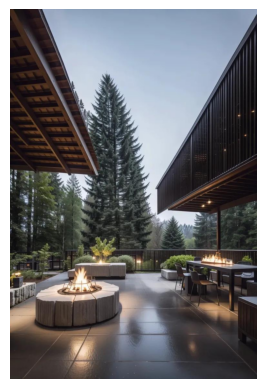

In [89]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

image_path = '/0a8a8eb5-43a6-4288-856f-f77e2b3fc66b.jpg'

# Load the image
img = mpimg.imread(image_path)

# Display the image
plt.imshow(img)
plt.axis('off')  # Turn off axis labels and ticks
plt.show()

In [97]:
img_pil = transforms.ToPILImage()(img)

transform = transforms.Compose([
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])

img_tensor = transform(img_pil)


In [93]:
print(img_tensor.shape)

torch.Size([3, 224, 224])


In [94]:
img_tensor = img_tensor.unsqueeze(0)
print(img_tensor.shape)

torch.Size([1, 3, 224, 224])


In [96]:
inference_model.eval()
with torch.no_grad():
    img_tensor = img_tensor.to(device)
    output = inference_model(img_tensor)
    print(output)

tensor([[0.9803]], device='cuda:0')


# Transfer learning Model From Vedansh for comparison

In [38]:
tl_model = models.resnet18(pretrained=True)

# Freeze all parameters except the final layer (transfer learning)
for param in tl_model.parameters():
    param.requires_grad = False

# Replace the final fully connected layer (custom classifier)
num_ftrs = tl_model.fc.in_features
tl_model.fc = nn.Sequential(
    nn.Linear(num_ftrs, 512),  # Fully connected layer
    nn.ReLU(),                 # Activation function
    nn.Dropout(0.5),           # Dropout for regularization
    nn.Linear(512, 1)          # Binary classification (real vs fake)
)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 198MB/s]


In [86]:
# load saved weights
tl_model.load_state_dict(torch.load('/content/fine_tuned_tl.pth'))
tl_model.eval()
tl_model = tl_model.to(device)
correct, total = 0, 0

with torch.no_grad():
    for imgs, labels in test_loader:
        imgs = imgs.to(device)
        labels = labels.to(device)

        outputs = tl_model(imgs)
        preds = (outputs.squeeze() > 0.5).long()
        correct += (preds == labels).sum().item()
        total += labels.size(0)

acc = correct / total
print(f"Test Accuracy for TL: {correct}/{total}: {acc}")

Test Accuracy for TL: 461/744: 0.6196236559139785
